In [1]:
import osmnx as ox
Lviv_road = ox.graph_from_place("Lviv,Ukraine")

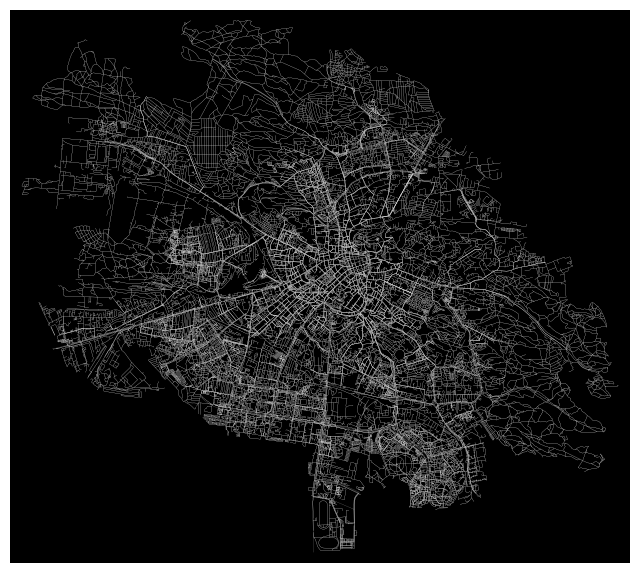

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [2]:
ox.plot_graph(Lviv_road,node_size=0, edge_linewidth=0.09, bgcolor='black', edge_color="white",
              show=True)

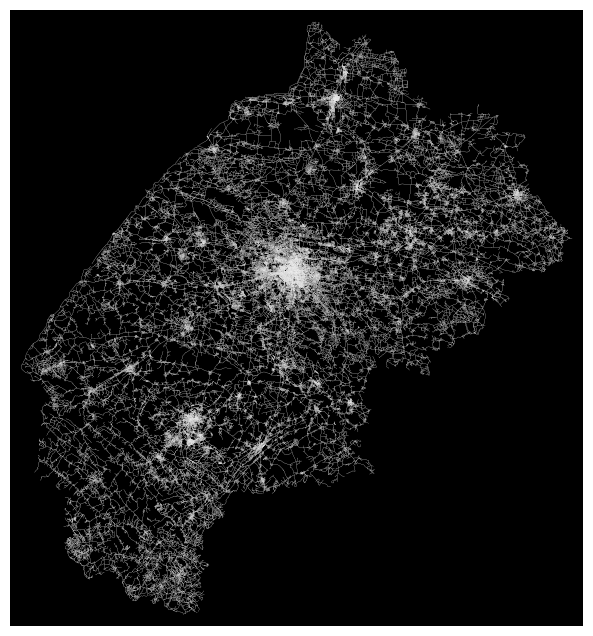

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [80]:
import geopandas
import osmnx as ox
import networkx

Lviv_obl = ox.graph_from_place("Lviv Oblast,Ukraine")

ox.plot_graph(Lviv_obl, node_size=0, edge_linewidth=0.09, bgcolor='black',
              edge_color="white", show=True)

In [81]:
nodes, edges = ox.graph_to_gdfs(Lviv_obl)
print("edges info:")
edges.head(5)

edges info:


osmid      highway  oneway reversed   length  \
u         v          key                                                     
251604622 2333375608 0    224517720  residential   False     True  101.777   
          3712589301 0    417552075        trunk   False    False  112.477   
          3712589300 0    417552075        trunk   False     True  134.821   
251604641 251604642  0    363128886        trunk   False     True   50.259   
          2333375837 0    224517733  residential   False    False  237.466   

                         lanes   ref                      name maxspeed  \
u         v          key                                                  
251604622 2333375608 0     NaN   NaN                       NaN      NaN   
          3712589301 0       2  М-06  вулиця Січових Стрільців       40   
          3712589300 0       2  М-06  вулиця Січових Стрільців       40   
251604641 251604642  0       2  М-06  вулиця Данила Галицького       50   
          2333375837 0     NaN   NaN             Зелена вулиця      NaN   

                                                                   geometry  \
u         v          key                                                      
251604622 2333375608 0    LINESTRING (23.58319 49.08787, 23.58450 49.08755)   
          3712589301 0    LINESTRING (23.58319 49.08787, 23.58370 49.08883)   
          3712589300 0    LINESTRING (23.58319 49.08787, 23.58306 49.087...   
251604641 251604642  0    LINESTRING (23.63534 49.10557, 23.63470 49.10541)   
          2333375837 0    LINESTRING (23.63534 49.10557, 23.63551 49.105...   

                         bridge service access tunnel width junction area  
u         v          key                                                   
251604622 2333375608 0      NaN     NaN    NaN    NaN   NaN      NaN  NaN  
          3712589301 0      NaN     NaN    NaN    NaN   NaN      NaN  NaN  
          3712589300 0      NaN     NaN    NaN    NaN   NaN      NaN  NaN  
251604641 251604642  0      NaN     NaN    NaN    NaN   NaN      NaN  NaN  
          2333375837 0      NaN     NaN    NaN    NaN   NaN      NaN  NaN

In [82]:
print("nodes info:")
nodes.head(5)

nodes info:


,y,x,street_count,highway,ref,geometry
osmid,,,,,,
251604622,49.087873,23.583191,3,NaN,NaN,POINT (23.58319 49.08787)
251604641,49.105571,23.635341,4,NaN,NaN,POINT (23.63534 49.10557)
251621077,48.887309,23.252997,3,NaN,NaN,POINT (23.25300 48.88731)
251621101,48.881146,23.285461,3,NaN,NaN,POINT (23.28546 48.88115)
251621172,48.916063,23.301357,3,NaN,NaN,POINT (23.30136 48.91606)


In [83]:
Route_45=[(49.80611220996008, 23.97955612862654),
(49.80532285209437, 23.98237781261442),
(49.80478275771747, 23.987291619711186),
(49.8042495817099, 23.99243073217024),
(49.80390336037501, 23.996432588052162),
(49.80395183150313, 23.999769256034998),
(49.80649303590949, 23.999114796958104),
(49.81293216592172, 24.000763128745433),
(49.81766865049101, 24.003570346218133),
(49.823736810282, 24.00771312858426),
(49.82582162024907, 24.00966317414233),
(49.832640701340466, 24.01859487887445),
(49.83680583050842, 24.02202637853643),
(49.840145382636926, 24.027186953530506),
(49.84012073274527, 24.028125056144603),
(49.839253501750214, 24.03253064738627)]

In [84]:
import geopandas
import osmnx as ox
import networkx
import heapq
import time
import matplotlib.pyplot as plt

In [85]:
import heapq
import time
import osmnx as ox

def calculate_route_length(graph, route):
    total_length = 0
    for i in range(len(route) - 1):
        node1 = route[i]
        node2 = route[i + 1]
        total_length += graph[node1][node2][0]['length']
    return total_length

def custom_dijkstra(graph, source, destination):
    pq = []
    heapq.heappush(pq, (0, source))
    distances = {source: 0}
    previous = {}
    
    while pq:
        current_distance, current_node = heapq.heappop(pq)
        
        if current_node == destination:
            break
        
        for neighbor, edge_data in graph[current_node].items():
            distance = current_distance + edge_data[0]['length']
            if neighbor not in distances or distance < distances[neighbor]:
                distances[neighbor] = distance
                previous[neighbor] = current_node
                heapq.heappush(pq, (distance, neighbor))
    
    shortest_path = []
    node = destination
    while node in previous:
        shortest_path.append(node)
        node = previous[node]
    shortest_path.append(source)
    shortest_path.reverse()
    
    return shortest_path
total_route=[]
def generate_path(graph, points):
    total_length = 0
    for i in range(len(points)-1):
        source = points[i]
        destination = points[i + 1]
        closest_nodes = ox.distance.nearest_nodes(graph, [source[1], destination[1]], [source[0], destination[0]])
        route = custom_dijkstra(graph, closest_nodes[0], closest_nodes[1])
        #print("Path from", source, "to", destination, ":", route)
        #print(i)
        length = calculate_route_length(graph, route)
        total_length += length
        total_route.append(route)
    return total_length

points = Route_45

timer_start = time.time()
total_length = generate_path(Lviv_obl, points)
timer_end = time.time()
time_total = timer_end - timer_start

print("Total length of the route:", round(total_length/1000, 4), "km")
print("Total route creation time:", time_total, "s")

Total length of the route: 7.3317 km
Total route creation time: 20.138867616653442 s


In [86]:
print(total_route)

[[4707001737, 7281168504, 7281168505, 6178474162, 3089011386, 3089011382, 3089011379, 6178474923, 4881495512, 257496526, 2396315354, 1897801933], [1897801933, 2396315354, 257496526, 257496527, 1003702336, 1843140519, 2977586880, 863255967, 2321896024], [2321896024, 863255970, 2396315340, 4936034639, 2396315336, 4582380142, 6696810149], [6696810149, 8812556234, 6178574191, 8163970158, 6349799188, 6349834683, 6349834677, 2060526800, 5115794303, 2512623651, 4580911856, 2512623653], [2512623653, 4580911856, 2512623651, 4936034637, 2500052969, 6349571850, 1601328715, 1607982636, 7893564261, 7893564260, 10086781716, 1895314981], [1895314981, 10086781716, 9082586718, 6349696664, 6349696663, 6349696667, 6308135431, 2977665679, 7609130651, 7609130667, 7609130661, 10893116728, 7609130671], [7609130671, 10893116725, 10893116722, 10893116721, 10893116734, 10893118268, 10893117085, 9082586737, 10893118255, 457365535, 856931080, 10893117943, 262066813, 7445094668, 1568276989, 6425291760, 2071470419,

Візуалізація маршруту

In [25]:
width = []
for i in total_route:
    width.append(0.2)
#print(width)

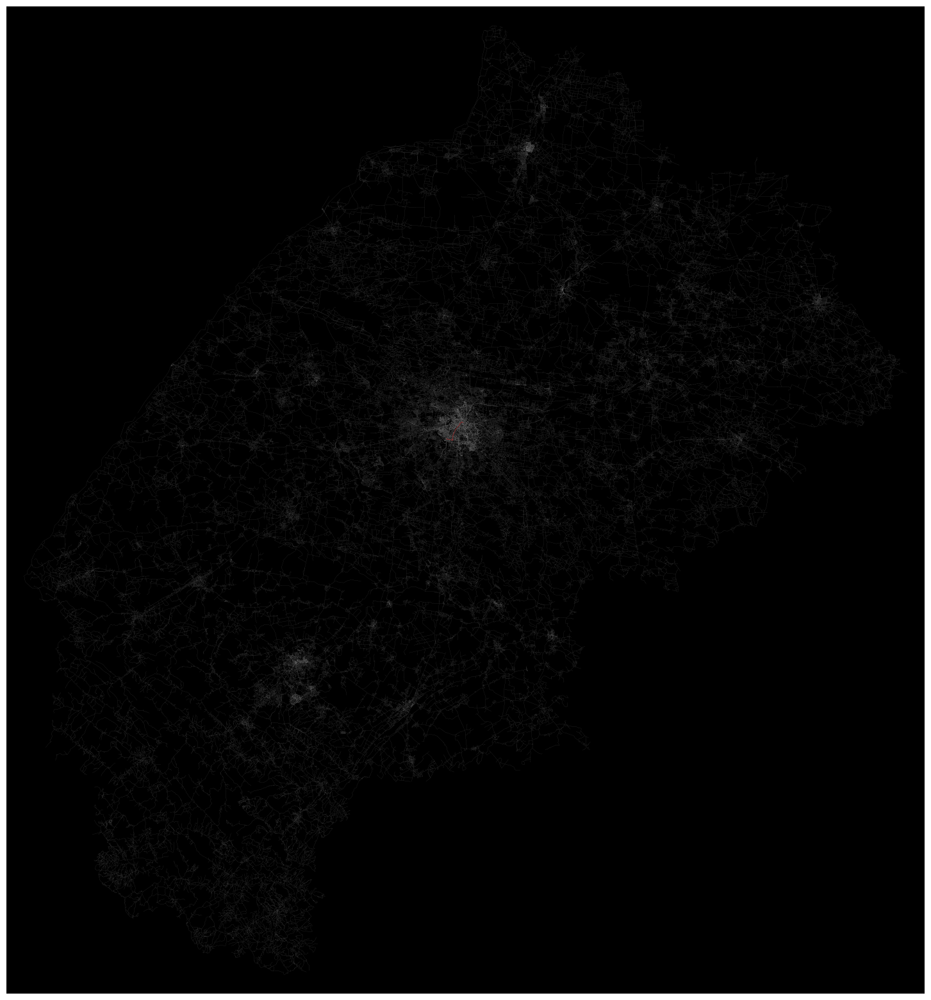

In [26]:
fig1, ax = ox.plot_graph_routes(Lviv_obl, total_route,figsize=(20,20),node_size=0, edge_linewidth=0.02, bgcolor='black', edge_color="white", 
                       show=True, route_linewidths=width, route_alpha=1, orig_dest_size=0.03 )

In [27]:
fig1.savefig('Route45.png', format='png', dpi=2000, bbox_inches='tight')

RL з DQM мережею для нагляду:

In [6]:
import osmnx as ox
import networkx as nx
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import random
from collections import deque
from tqdm import tqdm
import pickle

In [7]:
Lviv_obl = ox.graph_from_place("Lviv Oblast, Ukraine", network_type='drive')

In [8]:
Lviv_obl = nx.convert_node_labels_to_integers(Lviv_obl)

In [27]:
class DQN(nn.Module):
    def __init__(self, input_dim, hidden_dim=64):
        super(DQN, self).__init__()
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc3 = nn.Linear(hidden_dim, 1)
        
    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        return self.fc3(x)

In [28]:
class RouteAgent:
    def __init__(self, graph, start_node, goal_node, model_path='route_model.pth'):
        self.graph = graph
        self.start_node = start_node
        self.goal_node = goal_node
        self.current_node = start_node
        self.model_path = model_path
        
        self.epsilon = 1.0
        self.gamma = 0.9
        self.lr = 0.001
        self.memory = deque(maxlen=2000)
        self.batch_size = 32
        
        self.model = DQN(input_dim=2)
        self.optimizer = optim.Adam(self.model.parameters(), lr=self.lr)
        self.criterion = nn.MSELoss()
        
        self.load_model()
        
    def choose_action(self):
        neighbors = list(self.graph.neighbors(self.current_node))
        if not neighbors:
            return self.current_node
        
        if random.random() < self.epsilon:
            return random.choice(neighbors)
        else:
            with torch.no_grad():
                state_tensors = torch.tensor(
                    [[self.graph.nodes[n]['x'], self.graph.nodes[n]['y']] for n in neighbors],
                    dtype=torch.float32
                )
                q_values = self.model(state_tensors).squeeze()
                if q_values.ndimension() == 0:
                    return random.choice(neighbors)
                best_idx = torch.argmax(q_values).item()
                if best_idx >= len(neighbors):
                    return random.choice(neighbors)
                return neighbors[best_idx]
    
    def step(self, action):
        distance_to_goal = nx.shortest_path_length(self.graph, action, self.goal_node, weight='length')
        reward = -distance_to_goal
        
        done = action == self.goal_node
        self.memory.append((self.current_node, action, reward, done))
        self.current_node = action
        return done, distance_to_goal
    
    def train(self):
        if len(self.memory) < self.batch_size:
            return
        
        batch = random.sample(self.memory, self.batch_size)
        for state, action, reward, done in batch:
            state_tensor = torch.tensor([self.graph.nodes[state]['x'], self.graph.nodes[state]['y']], dtype=torch.float32)
            target = reward
            if not done:
                with torch.no_grad():
                    next_state_tensor = torch.tensor([self.graph.nodes[action]['x'], self.graph.nodes[action]['y']], dtype=torch.float32)
                    target += self.gamma * torch.max(self.model(next_state_tensor)).item()
            
            output = self.model(state_tensor)[0]
            loss = self.criterion(output, torch.tensor(target, dtype=torch.float32))
            
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()
        
        if self.epsilon > 0.1:
            self.epsilon *= 0.99
        
    def save_model(self):
        torch.save(self.model.state_dict(), self.model_path)
        with open(self.model_path.replace('.pth', '.pkl'), 'wb') as f:
            pickle.dump(self.memory, f)
    
    def load_model(self):
        try:
            self.model.load_state_dict(torch.load(self.model_path))
            with open(self.model_path.replace('.pth', '.pkl'), 'rb') as f:
                self.memory = pickle.load(f)
            print("Model loaded successfully.")
        except FileNotFoundError:
            print("No saved model found. Training from scratch.")


In [29]:
Route_45 = [
    (49.80611220996008, 23.97955612862654),
    (49.80532285209437, 23.98237781261442),
    (49.80478275771747, 23.987291619711186),
    (49.8042495817099, 23.99243073217024),
    (49.80390336037501, 23.996432588052162),
    (49.80395183150313, 23.999769256034998),
    (49.80649303590949, 23.999114796958104),
    (49.81293216592172, 24.000763128745433),
    (49.81766865049101, 24.003570346218133),
    (49.823736810282, 24.00771312858426),
    (49.82582162024907, 24.00966317414233),
    (49.832640701340466, 24.01859487887445),
    (49.83680583050842, 24.02202637853643),
    (49.840145382636926, 24.027186953530506),
    (49.84012073274527, 24.028125056144603),
    (49.839253501750214, 24.03253064738627)
]
route_points = Route_45
start_node = ox.distance.nearest_nodes(Lviv_obl, route_points[0][1], route_points[0][0])
goal_node = ox.distance.nearest_nodes(Lviv_obl, route_points[-1][1], route_points[-1][0])

agent = RouteAgent(Lviv_obl, start_node, goal_node)

for episode in tqdm(range(100), desc="Training Progress"):
    agent.current_node = agent.start_node
    done = False
    max_steps = 200
    steps_taken = 0
    
    initial_distance = nx.shortest_path_length(Lviv_obl, agent.start_node, agent.goal_node, weight='length')
    
    with tqdm(total=initial_distance, desc=f"Episode {episode+1} Progress", leave=False) as pbar:
        while not done and steps_taken < max_steps:
            action = agent.choose_action()
            done, remaining_distance = agent.step(action)
            agent.train()
            steps_taken += 1
            
            pbar.n = initial_distance - remaining_distance
            pbar.refresh()
    
    agent.save_model()
    print(f"Episode {episode+1}: Reached Node {agent.current_node} in {steps_taken} steps")


No saved model found. Training from scratch.


Training Progress:   0%|                                                                       | 0/100 [00:00<?, ?it/s]
Episode 1 Progress:   0%|                                                        | 0/6202.700000000001 [00:00<?, ?it/s]
C:\Users\Ryzen\AppData\Local\Programs\Python\Python310\lib\site-packages\tqdm\std.py:636: TqdmWarning: clamping frac to range [0, 1]
  full_bar = Bar(frac,
Episode 1 Progress:  -2%|                          | -148.33800000000065/6202.700000000001 [00:00<00:00, -21198.46it/s]
Episode 1 Progress:   0%|                                                      | 0.0/6202.700000000001 [00:00<?, ?it/s]
Episode 1 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -5814.17it/s]
Episode 1 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -19413.84it/s]
Episode 1 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -17736.17it/s]
Epis

Episode 1: Reached Node 23547 in 200 steps



Episode 2 Progress:   0%|                                                        | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 2 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4222.14it/s]
Episode 2 Progress: -11%|                            | -670.0020000000004/6202.700000000001 [00:00<00:00, -9161.57it/s]
Episode 2 Progress:  -5%|                        | -318.64999999999964/6202.700000000001 [00:00<-1:59:58, -2946.75it/s]
Episode 2 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4477.06it/s]
Episode 2 Progress:  -2%|                         | -148.33800000000065/6202.700000000001 [00:00<-1:59:52, -773.99it/s]
Episode 2 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2898.21it/s]
Episode 2 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2910.38it/s]
Episode 2 Progress: -11%|              

Episode 2: Reached Node 23172 in 200 steps



Episode 3 Progress:   0%|                                                        | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 3 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3954.33it/s]
Episode 3 Progress: -11%|                            | -670.0020000000004/6202.700000000001 [00:00<00:00, -8872.57it/s]
Episode 3 Progress: -12%|                            | -771.7719999999999/6202.700000000001 [00:00<00:00, -7046.55it/s]
Episode 3 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4619.58it/s]
Episode 3 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4263.15it/s]
Episode 3 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3051.70it/s]
Episode 3 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3031.89it/s]
Episode 3 Progress: -11%|              

Episode 3: Reached Node 23172 in 200 steps



Episode 4 Progress:   0%|                                                        | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 4 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4120.55it/s]
Episode 4 Progress: -11%|                            | -670.0020000000004/6202.700000000001 [00:00<00:00, -8920.57it/s]
Episode 4 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6823.74it/s]
Episode 4 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4347.26it/s]
Episode 4 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4006.17it/s]
Episode 4 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2879.97it/s]
Episode 4 Progress:  -2%|                         | -148.33800000000065/6202.700000000001 [00:00<-1:59:49, -539.09it/s]
Episode 4 Progress: -11%|              

Episode 4: Reached Node 23172 in 200 steps



Episode 5 Progress:   0%|                                                        | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 5 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3661.83it/s]
Episode 5 Progress: -11%|                            | -670.0020000000004/6202.700000000001 [00:00<00:00, -8533.63it/s]
Episode 5 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6430.25it/s]
Episode 5 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4349.94it/s]
Episode 5 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3998.01it/s]
Episode 5 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2801.90it/s]
Episode 5 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2745.29it/s]
Episode 5 Progress: -11%|              

Episode 5: Reached Node 23172 in 200 steps



Episode 6 Progress:   0%|                                                        | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 6 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4236.92it/s]
Episode 6 Progress: -11%|                            | -670.0020000000004/6202.700000000001 [00:00<00:00, -9922.22it/s]
Episode 6 Progress: -12%|                            | -771.7719999999999/6202.700000000001 [00:00<00:00, -7913.44it/s]
Episode 6 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -5094.24it/s]
Episode 6 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4565.46it/s]
Episode 6 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3283.60it/s]
Episode 6 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3215.07it/s]
Episode 6 Progress: -11%|              

Episode 6: Reached Node 23172 in 200 steps



Episode 7 Progress:   0%|                                                        | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 7 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4460.10it/s]
Episode 7 Progress: -11%|                            | -670.0020000000004/6202.700000000001 [00:00<00:00, -9816.20it/s]
Episode 7 Progress: -12%|                            | -771.7719999999999/6202.700000000001 [00:00<00:00, -7331.88it/s]
Episode 7 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4775.65it/s]
Episode 7 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4377.76it/s]
Episode 7 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3185.98it/s]
Episode 7 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3152.61it/s]
Episode 7 Progress: -11%|              

Episode 7: Reached Node 23172 in 200 steps



Episode 8 Progress:   0%|                                                        | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 8 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3708.41it/s]
Episode 8 Progress: -11%|                            | -670.0020000000004/6202.700000000001 [00:00<00:00, -8219.12it/s]
Episode 8 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6198.26it/s]
Episode 8 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4122.60it/s]
Episode 8 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3764.19it/s]
Episode 8 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2723.26it/s]
Episode 8 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2688.44it/s]
Episode 8 Progress: -11%|              

Episode 8: Reached Node 23172 in 200 steps



Episode 9 Progress:   0%|                                                        | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 9 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4099.43it/s]
Episode 9 Progress:   0%|                                                      | 0.0/6202.700000000001 [00:00<?, ?it/s]
Episode 9 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:56, -1437.59it/s]
Episode 9 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4778.34it/s]
Episode 9 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4404.54it/s]
Episode 9 Progress: -11%|                         | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3142.35it/s]
Episode 9 Progress: -12%|                         | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3095.19it/s]
Episode 9 Progress: -11%|              

Episode 9: Reached Node 23172 in 200 steps



Episode 10 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 10 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3449.17it/s]
Episode 10 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8067.10it/s]
Episode 10 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6171.57it/s]
Episode 10 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4108.40it/s]
Episode 10 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3838.09it/s]
Episode 10 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2779.08it/s]
Episode 10 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2810.54it/s]
Episode 10 Progress: -11%|             

Episode 10: Reached Node 23172 in 200 steps



Episode 11 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 11 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3661.62it/s]
Episode 11 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8120.32it/s]
Episode 11 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6567.31it/s]
Episode 11 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4266.78it/s]
Episode 11 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3917.04it/s]
Episode 11 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2844.38it/s]
Episode 11 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2852.59it/s]
Episode 11 Progress: -11%|             

Episode 11: Reached Node 23172 in 200 steps



Episode 12 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 12 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3850.81it/s]
Episode 12 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8320.70it/s]
Episode 12 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6429.40it/s]
Episode 12 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4239.43it/s]
Episode 12 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3916.85it/s]
Episode 12 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2861.85it/s]
Episode 12 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2846.66it/s]
Episode 12 Progress: -11%|             

Episode 12: Reached Node 23172 in 200 steps



Episode 13 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 13 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4175.92it/s]
Episode 13 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9368.12it/s]
Episode 13 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7177.71it/s]
Episode 13 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4651.74it/s]
Episode 13 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4193.65it/s]
Episode 13 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3010.67it/s]
Episode 13 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2985.08it/s]
Episode 13 Progress: -11%|             

Episode 13: Reached Node 23172 in 200 steps



Episode 14 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 14 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3803.35it/s]
Episode 14 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8756.07it/s]
Episode 14 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6623.59it/s]
Episode 14 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4253.33it/s]
Episode 14 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:52, -752.85it/s]
Episode 14 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2862.81it/s]
Episode 14 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2800.85it/s]
Episode 14 Progress: -11%|             

Episode 14: Reached Node 23172 in 200 steps



Episode 15 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 15 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4230.35it/s]
Episode 15 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8925.64it/s]
Episode 15 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6677.63it/s]
Episode 15 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4362.59it/s]
Episode 15 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3986.66it/s]
Episode 15 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2874.37it/s]
Episode 15 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2878.69it/s]
Episode 15 Progress: -11%|             

Episode 15: Reached Node 23172 in 200 steps



Episode 16 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 16 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4063.29it/s]
Episode 16 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9114.29it/s]
Episode 16 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7210.92it/s]
Episode 16 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4651.97it/s]
Episode 16 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4193.85it/s]
Episode 16 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3051.89it/s]
Episode 16 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2996.72it/s]
Episode 16 Progress: -11%|             

Episode 16: Reached Node 23547 in 200 steps



Episode 17 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 17 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3803.63it/s]
Episode 17 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9113.94it/s]
Episode 17 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6859.36it/s]
Episode 17 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4451.39it/s]
Episode 17 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4134.90it/s]
Episode 17 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2969.23it/s]
Episode 17 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2916.12it/s]
Episode 17 Progress: -11%|             

Episode 17: Reached Node 23172 in 200 steps



Episode 18 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 18 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3531.63it/s]
Episode 18 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8021.47it/s]
Episode 18 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6099.76it/s]
Episode 18 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3987.10it/s]
Episode 18 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3691.87it/s]
Episode 18 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2690.29it/s]
Episode 18 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2637.96it/s]
Episode 18 Progress: -11%|             

Episode 18: Reached Node 23172 in 200 steps



Episode 19 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 19 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4486.47it/s]
Episode 19 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9701.79it/s]
Episode 19 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7713.22it/s]
Episode 19 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4996.09it/s]
Episode 19 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4591.00it/s]
Episode 19 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3365.08it/s]
Episode 19 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3303.54it/s]
Episode 19 Progress: -11%|             

Episode 19: Reached Node 23172 in 200 steps



Episode 20 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 20 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:58, -3090.12it/s]
Episode 20 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -6870.48it/s]
Episode 20 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -5196.17it/s]
Episode 20 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3366.08it/s]
Episode 20 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3149.48it/s]
Episode 20 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2305.90it/s]
Episode 20 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:57, -2252.90it/s]
Episode 20 Progress: -11%|             

Episode 20: Reached Node 23172 in 200 steps



Episode 21 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 21 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4008.29it/s]
Episode 21 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9298.41it/s]
Episode 21 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7012.42it/s]
Episode 21 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4539.72it/s]
Episode 21 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4049.47it/s]
Episode 21 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2905.53it/s]
Episode 21 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2846.77it/s]
Episode 21 Progress: -11%|             

Episode 21: Reached Node 23172 in 200 steps



Episode 22 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 22 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3715.72it/s]
Episode 22 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8150.33it/s]
Episode 22 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6083.68it/s]
Episode 22 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3989.92it/s]
Episode 22 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3753.72it/s]
Episode 22 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2756.17it/s]
Episode 22 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2725.79it/s]
Episode 22 Progress: -11%|             

Episode 22: Reached Node 23172 in 200 steps



Episode 23 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 23 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3235.67it/s]
Episode 23 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -7389.62it/s]
Episode 23 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -5790.51it/s]
Episode 23 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3786.85it/s]
Episode 23 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3524.53it/s]
Episode 23 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2566.06it/s]
Episode 23 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2498.94it/s]
Episode 23 Progress: -11%|             

Episode 23: Reached Node 23172 in 200 steps



Episode 24 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 24 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:58, -3059.16it/s]
Episode 24 Progress:   0%|                                                     | 0.0/6202.700000000001 [00:00<?, ?it/s]
Episode 24 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:55, -1067.11it/s]
Episode 24 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3742.86it/s]
Episode 24 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3515.48it/s]
Episode 24 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2611.70it/s]
Episode 24 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2602.60it/s]
Episode 24 Progress: -11%|             

Episode 24: Reached Node 23172 in 200 steps



Episode 25 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 25 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4238.13it/s]
Episode 25 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9708.80it/s]
Episode 25 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7677.73it/s]
Episode 25 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4943.99it/s]
Episode 25 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4565.85it/s]
Episode 25 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3283.74it/s]
Episode 25 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3201.91it/s]
Episode 25 Progress: -11%|             

Episode 25: Reached Node 23172 in 200 steps



Episode 26 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 26 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3488.91it/s]
Episode 26 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -7927.38it/s]
Episode 26 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6122.99it/s]
Episode 26 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3963.47it/s]
Episode 26 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:52, -709.58it/s]
Episode 26 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2717.37it/s]
Episode 26 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2665.30it/s]
Episode 26 Progress: -11%|             

Episode 26: Reached Node 23172 in 200 steps



Episode 27 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 27 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4238.25it/s]
Episode 27 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9710.41it/s]
Episode 27 Progress:  -5%|                       | -318.64999999999964/6202.700000000001 [00:00<-1:59:58, -3078.43it/s]
Episode 27 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4837.19it/s]
Episode 27 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4422.54it/s]
Episode 27 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3220.85it/s]
Episode 27 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3215.37it/s]
Episode 27 Progress: -11%|             

Episode 27: Reached Node 23172 in 200 steps



Episode 28 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 28 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4635.55it/s]
Episode 28 Progress: -11%|                          | -670.0020000000004/6202.700000000001 [00:00<00:00, -10307.37it/s]
Episode 28 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7342.01it/s]
Episode 28 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4554.10it/s]
Episode 28 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3846.65it/s]
Episode 28 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2750.01it/s]
Episode 28 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2678.33it/s]
Episode 28 Progress: -11%|             

Episode 28: Reached Node 23172 in 200 steps



Episode 29 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 29 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4785.33it/s]
Episode 29 Progress: -11%|                          | -670.0020000000004/6202.700000000001 [00:00<00:00, -10983.49it/s]
Episode 29 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:57, -1630.02it/s]
Episode 29 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -5401.85it/s]
Episode 29 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4822.59it/s]
Episode 29 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3461.78it/s]
Episode 29 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3406.68it/s]
Episode 29 Progress: -11%|             

Episode 29: Reached Node 23172 in 200 steps



Episode 30 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 30 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4944.41it/s]
Episode 30 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9923.77it/s]
Episode 30 Progress:  -5%|                       | -318.64999999999964/6202.700000000001 [00:00<-1:59:58, -3234.56it/s]
Episode 30 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4907.78it/s]
Episode 30 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4565.99it/s]
Episode 30 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3316.37it/s]
Episode 30 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3255.90it/s]
Episode 30 Progress: -11%|             

Episode 30: Reached Node 23172 in 200 steps



Episode 31 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 31 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3851.14it/s]
Episode 31 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8872.26it/s]
Episode 31 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6623.53it/s]
Episode 31 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4266.59it/s]
Episode 31 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3916.94it/s]
Episode 31 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2856.61it/s]
Episode 31 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2831.68it/s]
Episode 31 Progress: -11%|             

Episode 31: Reached Node 32080 in 200 steps



Episode 32 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 32 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4176.54it/s]
Episode 32 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9368.40it/s]
Episode 32 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7178.00it/s]
Episode 32 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4700.27it/s]
Episode 32 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4371.55it/s]
Episode 32 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3152.28it/s]
Episode 32 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3111.23it/s]
Episode 32 Progress: -11%|             

Episode 32: Reached Node 23172 in 200 steps



Episode 33 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 33 Progress:   1%|▏                           | 43.279999999999745/6202.700000000001 [00:00<00:05, 1109.74it/s]
Episode 33 Progress:   3%|▋                           | 159.96500000000015/6202.700000000001 [00:00<00:03, 1950.64it/s]
Episode 33 Progress:   3%|▊                            | 168.6319999999996/6202.700000000001 [00:00<00:04, 1354.26it/s]
Episode 33 Progress:   3%|▊                           | 174.03300000000036/6202.700000000001 [00:00<00:05, 1064.28it/s]
Episode 33 Progress:  -4%|                                  | -259.933/6202.700000000001 [00:00<-1:59:55, -1255.48it/s]
Episode 33 Progress: -40%|                          | -2490.5550000000003/6202.700000000001 [00:00<00:00, -9689.40it/s]
Episode 33 Progress: -39%|                       | -2443.0559999999987/6202.700000000001 [00:00<-1:59:59, -8054.39it/s]
Episode 33 Progress: -37%|             

Episode 33: Reached Node 26643 in 200 steps



Episode 34 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 34 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3798.77it/s]
Episode 34 Progress:   0%|                                                     | 0.0/6202.700000000001 [00:00<?, ?it/s]
Episode 34 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:55, -1267.31it/s]
Episode 34 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4420.47it/s]
Episode 34 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4136.71it/s]
Episode 34 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2983.43it/s]
Episode 34 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3025.61it/s]
Episode 34 Progress: -11%|             

Episode 34: Reached Node 23172 in 200 steps



Episode 35 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 35 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:58, -2535.03it/s]
Episode 35 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -6732.05it/s]
Episode 35 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -5433.61it/s]
Episode 35 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3700.93it/s]
Episode 35 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3304.46it/s]
Episode 35 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2458.23it/s]
Episode 35 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2441.68it/s]
Episode 35 Progress: -11%|             

Episode 35: Reached Node 23172 in 200 steps



Episode 36 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 36 Progress:   1%|▏                           | 43.279999999999745/6202.700000000001 [00:00<00:04, 1309.25it/s]
Episode 36 Progress:   3%|▋                           | 159.96500000000015/6202.700000000001 [00:00<00:02, 2350.55it/s]
Episode 36 Progress:   3%|▊                            | 168.6319999999996/6202.700000000001 [00:00<00:03, 1668.72it/s]
Episode 36 Progress:   3%|▊                           | 174.03300000000036/6202.700000000001 [00:00<00:04, 1307.67it/s]
Episode 36 Progress:  -4%|                                  | -259.933/6202.700000000001 [00:00<-1:59:56, -1574.53it/s]
Episode 36 Progress: -40%|                         | -2490.5550000000003/6202.700000000001 [00:00<00:00, -12324.26it/s]
Episode 36 Progress: -39%|                         | -2443.0559999999987/6202.700000000001 [00:00<00:00, -10238.98it/s]
Episode 36 Progress: -37%|             

Episode 36: Reached Node 27823 in 200 steps



Episode 37 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 37 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4062.33it/s]
Episode 37 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9637.81it/s]
Episode 37 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7112.04it/s]
Episode 37 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4653.32it/s]
Episode 37 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4264.34it/s]
Episode 37 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3045.61it/s]
Episode 37 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3032.54it/s]
Episode 37 Progress: -11%|             

Episode 37: Reached Node 23172 in 200 steps



Episode 38 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 38 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4563.34it/s]
Episode 38 Progress: -11%|                          | -670.0020000000004/6202.700000000001 [00:00<00:00, -10073.96it/s]
Episode 38 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7678.39it/s]
Episode 38 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -5113.61it/s]
Episode 38 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4676.71it/s]
Episode 38 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3316.39it/s]
Episode 38 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3290.56it/s]
Episode 38 Progress: -11%|             

Episode 38: Reached Node 23172 in 200 steps



Episode 39 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 39 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3448.86it/s]
Episode 39 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -7744.03it/s]
Episode 39 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6248.35it/s]
Episode 39 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4070.67it/s]
Episode 39 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3828.40it/s]
Episode 39 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2808.11it/s]
Episode 39 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2795.12it/s]
Episode 39 Progress: -11%|             

Episode 39: Reached Node 23172 in 200 steps



Episode 40 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 40 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3753.94it/s]
Episode 40 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8219.56it/s]
Episode 40 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6027.53it/s]
Episode 40 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4011.06it/s]
Episode 40 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3810.31it/s]
Episode 40 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2832.35it/s]
Episode 40 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2842.05it/s]
Episode 40 Progress: -11%|             

Episode 40: Reached Node 29983 in 200 steps



Episode 41 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 41 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4355.93it/s]
Episode 41 Progress: -11%|                          | -670.0020000000004/6202.700000000001 [00:00<00:00, -10143.23it/s]
Episode 41 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7488.66it/s]
Episode 41 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4941.54it/s]
Episode 41 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4605.39it/s]
Episode 41 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3373.87it/s]
Episode 41 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3255.02it/s]
Episode 41 Progress: -11%|             

Episode 41: Reached Node 23172 in 200 steps



Episode 42 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 42 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3573.38it/s]
Episode 42 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8219.29it/s]
Episode 42 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6324.10it/s]
Episode 42 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4109.53it/s]
Episode 42 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3763.97it/s]
Episode 42 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2762.25it/s]
Episode 42 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2741.08it/s]
Episode 42 Progress: -11%|             

Episode 42: Reached Node 23172 in 200 steps



Episode 43 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 43 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4119.27it/s]
Episode 43 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9500.79it/s]
Episode 43 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7046.95it/s]
Episode 43 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4465.41it/s]
Episode 43 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4148.41it/s]
Episode 43 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3017.47it/s]
Episode 43 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3031.81it/s]
Episode 43 Progress: -11%|             

Episode 43: Reached Node 23172 in 200 steps



Episode 44 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 44 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3708.41it/s]
Episode 44 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8644.19it/s]
Episode 44 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6799.03it/s]
Episode 44 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4481.08it/s]
Episode 44 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4126.42it/s]
Episode 44 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2951.15it/s]
Episode 44 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2939.57it/s]
Episode 44 Progress: -11%|             

Episode 44: Reached Node 23172 in 200 steps



Episode 45 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 45 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4238.13it/s]
Episode 45 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9920.93it/s]
Episode 45 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7753.92it/s]
Episode 45 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -5093.79it/s]
Episode 45 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4620.22it/s]
Episode 45 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3332.55it/s]
Episode 45 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3269.62it/s]
Episode 45 Progress: -11%|             

Episode 45: Reached Node 23172 in 200 steps



Episode 46 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 46 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3803.44it/s]
Episode 46 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9436.73it/s]
Episode 46 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7384.63it/s]
Episode 46 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4734.63it/s]
Episode 46 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4372.31it/s]
Episode 46 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3130.47it/s]
Episode 46 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3111.66it/s]
Episode 46 Progress: -11%|             

Episode 46: Reached Node 23172 in 200 steps



Episode 47 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 47 Progress:   1%|▏                           | 43.279999999999745/6202.700000000001 [00:00<00:05, 1095.14it/s]
Episode 47 Progress:   3%|▋                           | 159.96500000000015/6202.700000000001 [00:00<00:02, 2063.47it/s]
Episode 47 Progress:   3%|▊                            | 168.6319999999996/6202.700000000001 [00:00<00:04, 1434.92it/s]
Episode 47 Progress:   3%|▊                           | 174.03300000000036/6202.700000000001 [00:00<00:05, 1101.22it/s]
Episode 47 Progress:  -4%|                                  | -259.933/6202.700000000001 [00:00<-1:59:56, -1360.64it/s]
Episode 47 Progress: -40%|                         | -2490.5550000000003/6202.700000000001 [00:00<00:00, -10779.36it/s]
Episode 47 Progress: -39%|                          | -2443.0559999999987/6202.700000000001 [00:00<00:00, -8801.82it/s]
Episode 47 Progress: -37%|             

Episode 47: Reached Node 31071 in 200 steps



Episode 48 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 48 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3903.84it/s]
Episode 48 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9367.87it/s]
Episode 48 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:56, -1306.72it/s]
Episode 48 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4364.06it/s]
Episode 48 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3997.97it/s]
Episode 48 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2925.30it/s]
Episode 48 Progress:  -5%|                       | -318.64999999999964/6202.700000000001 [00:00<-1:59:55, -1197.73it/s]
Episode 48 Progress: -11%|             

Episode 48: Reached Node 23172 in 200 steps



Episode 49 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 49 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3617.93it/s]
Episode 49 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8119.76it/s]
Episode 49 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6148.83it/s]
Episode 49 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3883.63it/s]
Episode 49 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3572.44it/s]
Episode 49 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2627.13it/s]
Episode 49 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2620.15it/s]
Episode 49 Progress: -11%|             

Episode 49: Reached Node 23172 in 200 steps



Episode 50 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 50 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4362.59it/s]
Episode 50 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9779.55it/s]
Episode 50 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7178.51it/s]
Episode 50 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4668.50it/s]
Episode 50 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:53, -833.24it/s]
Episode 50 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3045.07it/s]
Episode 50 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2996.54it/s]
Episode 50 Progress: -11%|             

Episode 50: Reached Node 23172 in 200 steps



Episode 51 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 51 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4298.00it/s]
Episode 51 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9239.49it/s]
Episode 51 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7046.51it/s]
Episode 51 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4587.75it/s]
Episode 51 Progress:  -5%|                       | -318.64999999999964/6202.700000000001 [00:00<-1:59:57, -1769.90it/s]
Episode 51 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3024.05it/s]
Episode 51 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2996.09it/s]
Episode 51 Progress: -11%|             

Episode 51: Reached Node 23172 in 200 steps



Episode 52 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 52 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4238.07it/s]
Episode 52 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9054.04it/s]
Episode 52 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -6983.36it/s]
Episode 52 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4451.37it/s]
Episode 52 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4093.84it/s]
Episode 52 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2900.00it/s]
Episode 52 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2816.33it/s]
Episode 52 Progress: -11%|             

Episode 52: Reached Node 23172 in 200 steps



Episode 53 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 53 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4494.22it/s]
Episode 53 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9435.91it/s]
Episode 53 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7245.43it/s]
Episode 53 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4701.14it/s]
Episode 53 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4422.24it/s]
Episode 53 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3115.69it/s]
Episode 53 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3086.61it/s]
Episode 53 Progress: -11%|             

Episode 53: Reached Node 23172 in 200 steps



Episode 54 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 54 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3531.77it/s]
Episode 54 Progress:   0%|                                                     | 0.0/6202.700000000001 [00:00<?, ?it/s]
Episode 54 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:55, -1241.19it/s]
Episode 54 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4174.11it/s]
Episode 54 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3820.05it/s]
Episode 54 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2723.25it/s]
Episode 54 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2660.95it/s]
Episode 54 Progress: -11%|             

Episode 54: Reached Node 23172 in 200 steps



Episode 55 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 55 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4494.70it/s]
Episode 55 Progress: -11%|                          | -670.0020000000004/6202.700000000001 [00:00<00:00, -10142.86it/s]
Episode 55 Progress:  -5%|                       | -318.64999999999964/6202.700000000001 [00:00<-1:59:58, -3184.78it/s]
Episode 55 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4888.47it/s]
Episode 55 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4390.70it/s]
Episode 55 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3148.47it/s]
Episode 55 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:50, -596.19it/s]
Episode 55 Progress: -11%|             

Episode 55: Reached Node 23172 in 200 steps



Episode 56 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 56 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3954.31it/s]
Episode 56 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8992.07it/s]
Episode 56 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6859.12it/s]
Episode 56 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4378.32it/s]
Episode 56 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4061.41it/s]
Episode 56 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2944.36it/s]
Episode 56 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2884.58it/s]
Episode 56 Progress: -11%|             

Episode 56: Reached Node 23172 in 200 steps



Episode 57 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 57 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3371.03it/s]
Episode 57 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -7484.11it/s]
Episode 57 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -5653.05it/s]
Episode 57 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3640.51it/s]
Episode 57 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3384.35it/s]
Episode 57 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2476.31it/s]
Episode 57 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2461.29it/s]
Episode 57 Progress: -11%|             

Episode 57: Reached Node 26401 in 200 steps



Episode 58 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 58 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4635.48it/s]
Episode 58 Progress: -11%|                          | -670.0020000000004/6202.700000000001 [00:00<00:00, -10151.33it/s]
Episode 58 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7632.76it/s]
Episode 58 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4747.91it/s]
Episode 58 Progress:  -5%|                       | -318.64999999999964/6202.700000000001 [00:00<-1:59:57, -1788.91it/s]
Episode 58 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3151.04it/s]
Episode 58 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3091.67it/s]
Episode 58 Progress: -11%|             

Episode 58: Reached Node 32080 in 200 steps



Episode 59 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 59 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4120.42it/s]
Episode 59 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8701.15it/s]
Episode 59 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6567.31it/s]
Episode 59 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4308.18it/s]
Episode 59 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4114.27it/s]
Episode 59 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2983.29it/s]
Episode 59 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2905.83it/s]
Episode 59 Progress: -11%|             

Episode 59: Reached Node 23172 in 200 steps



Episode 60 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 60 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4495.06it/s]
Episode 60 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9113.11it/s]
Episode 60 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7177.98it/s]
Episode 60 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4701.22it/s]
Episode 60 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4345.54it/s]
Episode 60 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3107.56it/s]
Episode 60 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3043.12it/s]
Episode 60 Progress: -11%|             

Episode 60: Reached Node 23172 in 200 steps



Episode 61 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 61 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4362.46it/s]
Episode 61 Progress: -11%|                          | -670.0020000000004/6202.700000000001 [00:00<00:00, -10151.44it/s]
Episode 61 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7636.67it/s]
Episode 61 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4888.34it/s]
Episode 61 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4564.97it/s]
Episode 61 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3290.96it/s]
Episode 61 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3248.35it/s]
Episode 61 Progress: -11%|             

Episode 61: Reached Node 23172 in 200 steps



Episode 62 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 62 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3903.72it/s]
Episode 62 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9367.46it/s]
Episode 62 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7527.91it/s]
Episode 62 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4802.11it/s]
Episode 62 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4460.11it/s]
Episode 62 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3267.71it/s]
Episode 62 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3149.57it/s]
Episode 62 Progress: -11%|             

Episode 62: Reached Node 23172 in 200 steps



Episode 63 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 63 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3851.90it/s]
Episode 63 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9114.29it/s]
Episode 63 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7112.12it/s]
Episode 63 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4619.85it/s]
Episode 63 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4171.23it/s]
Episode 63 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3038.12it/s]
Episode 63 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2985.11it/s]
Episode 63 Progress: -11%|             

Episode 63: Reached Node 23172 in 200 steps



Episode 64 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 64 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3531.73it/s]
Episode 64 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8219.10it/s]
Episode 64 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6681.13it/s]
Episode 64 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4294.00it/s]
Episode 64 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4018.94it/s]
Episode 64 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2912.66it/s]
Episode 64 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2895.40it/s]
Episode 64 Progress: -11%|             

Episode 64: Reached Node 32080 in 200 steps



Episode 65 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 65 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3953.78it/s]
Episode 65 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8872.07it/s]
Episode 65 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -6983.01it/s]
Episode 65 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4556.70it/s]
Episode 65 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4148.52it/s]
Episode 65 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3024.19it/s]
Episode 65 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2985.03it/s]
Episode 65 Progress: -11%|             

Episode 65: Reached Node 23172 in 200 steps



Episode 66 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 66 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4783.64it/s]
Episode 66 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9636.88it/s]
Episode 66 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7313.89it/s]
Episode 66 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4733.95it/s]
Episode 66 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4286.60it/s]
Episode 66 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3086.94it/s]
Episode 66 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3031.68it/s]
Episode 66 Progress: -11%|             

Episode 66: Reached Node 23172 in 200 steps



Episode 67 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 67 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4562.67it/s]
Episode 67 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9369.24it/s]
Episode 67 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7245.33it/s]
Episode 67 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4651.96it/s]
Episode 67 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4335.15it/s]
Episode 67 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3045.04it/s]
Episode 67 Progress:  -5%|                       | -318.64999999999964/6202.700000000001 [00:00<-1:59:55, -1234.29it/s]
Episode 67 Progress: -11%|             

Episode 67: Reached Node 23172 in 200 steps



Episode 68 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 68 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3258.70it/s]
Episode 68 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -7484.64it/s]
Episode 68 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6027.48it/s]
Episode 68 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3987.14it/s]
Episode 68 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3691.98it/s]
Episode 68 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2717.42it/s]
Episode 68 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2693.27it/s]
Episode 68 Progress: -11%|             

Episode 68: Reached Node 23172 in 200 steps



Episode 69 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 69 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4009.01it/s]
Episode 69 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8931.96it/s]
Episode 69 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6858.86it/s]
Episode 69 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4572.67it/s]
Episode 69 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4170.92it/s]
Episode 69 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3058.86it/s]
Episode 69 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2967.95it/s]
Episode 69 Progress: -11%|             

Episode 69: Reached Node 23172 in 200 steps



Episode 70 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 70 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4495.12it/s]
Episode 70 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9999.94it/s]
Episode 70 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7528.31it/s]
Episode 70 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4734.53it/s]
Episode 70 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4359.72it/s]
Episode 70 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3115.83it/s]
Episode 70 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3074.43it/s]
Episode 70 Progress: -11%|             

Episode 70: Reached Node 23172 in 200 steps



Episode 71 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 71 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4008.93it/s]
Episode 71 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9501.44it/s]
Episode 71 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7314.20it/s]
Episode 71 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4701.06it/s]
Episode 71 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4286.75it/s]
Episode 71 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3130.31it/s]
Episode 71 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3074.28it/s]
Episode 71 Progress: -11%|             

Episode 71: Reached Node 23172 in 200 steps



Episode 72 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 72 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4009.19it/s]
Episode 72 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8532.75it/s]
Episode 72 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6798.50it/s]
Episode 72 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4480.97it/s]
Episode 72 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4170.88it/s]
Episode 72 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3044.89it/s]
Episode 72 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2985.02it/s]
Episode 72 Progress: -11%|             

Episode 72: Reached Node 23172 in 200 steps



Episode 73 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 73 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4063.10it/s]
Episode 73 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9114.74it/s]
Episode 73 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6951.73it/s]
Episode 73 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4620.08it/s]
Episode 73 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4263.50it/s]
Episode 73 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3108.44it/s]
Episode 73 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3068.20it/s]
Episode 73 Progress: -11%|             

Episode 73: Reached Node 23172 in 200 steps



Episode 74 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 74 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4362.80it/s]
Episode 74 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9436.95it/s]
Episode 74 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7112.17it/s]
Episode 74 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4364.39it/s]
Episode 74 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3988.07it/s]
Episode 74 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2712.19it/s]
Episode 74 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2670.13it/s]
Episode 74 Progress: -11%|             

Episode 74: Reached Node 23172 in 200 steps



Episode 75 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 75 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3903.50it/s]
Episode 75 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9280.75it/s]
Episode 75 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7003.82it/s]
Episode 75 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4460.76it/s]
Episode 75 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4089.72it/s]
Episode 75 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2968.40it/s]
Episode 75 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2931.95it/s]
Episode 75 Progress: -11%|             

Episode 75: Reached Node 23172 in 200 steps



Episode 76 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 76 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4009.32it/s]
Episode 76 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8812.20it/s]
Episode 76 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7078.39it/s]
Episode 76 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4651.75it/s]
Episode 76 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4204.58it/s]
Episode 76 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3051.68it/s]
Episode 76 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3019.93it/s]
Episode 76 Progress: -11%|             

Episode 76: Reached Node 23172 in 200 steps



Episode 77 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 77 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4784.60it/s]
Episode 77 Progress: -11%|                          | -670.0020000000004/6202.700000000001 [00:00<00:00, -10385.39it/s]
Episode 77 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7528.73it/s]
Episode 77 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4854.22it/s]
Episode 77 Progress:  -5%|                       | -318.64999999999964/6202.700000000001 [00:00<-1:59:57, -1810.27it/s]
Episode 77 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3101.52it/s]
Episode 77 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3105.13it/s]
Episode 77 Progress: -11%|             

Episode 77: Reached Node 23172 in 200 steps



Episode 78 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 78 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4362.92it/s]
Episode 78 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9177.10it/s]
Episode 78 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7111.86it/s]
Episode 78 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4511.23it/s]
Episode 78 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4170.95it/s]
Episode 78 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3031.17it/s]
Episode 78 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2990.92it/s]
Episode 78 Progress: -11%|             

Episode 78: Reached Node 23172 in 200 steps



Episode 79 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 79 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3803.47it/s]
Episode 79 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8533.42it/s]
Episode 79 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6739.52it/s]
Episode 79 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4450.99it/s]
Episode 79 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4171.01it/s]
Episode 79 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3072.92it/s]
Episode 79 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3062.06it/s]
Episode 79 Progress: -11%|             

Episode 79: Reached Node 23172 in 200 steps



Episode 80 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 80 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4562.87it/s]
Episode 80 Progress: -11%|                          | -670.0020000000004/6202.700000000001 [00:00<00:00, -10073.56it/s]
Episode 80 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7419.45it/s]
Episode 80 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4784.82it/s]
Episode 80 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4287.00it/s]
Episode 80 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3051.84it/s]
Episode 80 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2950.90it/s]
Episode 80 Progress: -11%|             

Episode 80: Reached Node 23172 in 200 steps



Episode 81 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 81 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3572.31it/s]
Episode 81 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8642.25it/s]
Episode 81 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6798.12it/s]
Episode 81 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4436.02it/s]
Episode 81 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4126.28it/s]
Episode 81 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2944.35it/s]
Episode 81 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2842.05it/s]
Episode 81 Progress: -11%|             

Episode 81: Reached Node 23172 in 200 steps



Episode 82 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 82 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3258.21it/s]
Episode 82 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -7163.83it/s]
Episode 82 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -5736.78it/s]
Episode 82 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3805.85it/s]
Episode 82 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3523.31it/s]
Episode 82 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2581.20it/s]
Episode 82 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2550.73it/s]
Episode 82 Progress: -11%|             

Episode 82: Reached Node 23172 in 200 steps



Episode 83 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 83 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4120.83it/s]
Episode 83 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9053.66it/s]
Episode 83 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6944.80it/s]
Episode 83 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4523.05it/s]
Episode 83 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4157.13it/s]
Episode 83 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3022.83it/s]
Episode 83 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2972.34it/s]
Episode 83 Progress: -11%|             

Episode 83: Reached Node 23172 in 200 steps



Episode 84 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 84 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3531.81it/s]
Episode 84 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8019.95it/s]
Episode 84 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6197.72it/s]
Episode 84 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4047.62it/s]
Episode 84 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3763.97it/s]
Episode 84 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2745.40it/s]
Episode 84 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2731.40it/s]
Episode 84 Progress: -11%|             

Episode 84: Reached Node 23172 in 200 steps



Episode 85 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 85 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4298.78it/s]
Episode 85 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9240.47it/s]
Episode 85 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7112.23it/s]
Episode 85 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4684.61it/s]
Episode 85 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4310.97it/s]
Episode 85 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3127.84it/s]
Episode 85 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3096.95it/s]
Episode 85 Progress: -11%|             

Episode 85: Reached Node 29051 in 200 steps



Episode 86 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 86 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3449.61it/s]
Episode 86 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8533.01it/s]
Episode 86 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6567.34it/s]
Episode 86 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4335.93it/s]
Episode 86 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3957.14it/s]
Episode 86 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2875.11it/s]
Episode 86 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2842.02it/s]
Episode 86 Progress: -11%|             

Episode 86: Reached Node 32080 in 200 steps



Episode 87 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 87 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4237.67it/s]
Episode 87 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9570.55it/s]
Episode 87 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7313.66it/s]
Episode 87 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4802.05it/s]
Episode 87 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4473.18it/s]
Episode 87 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3267.61it/s]
Episode 87 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3242.09it/s]
Episode 87 Progress: -11%|             

Episode 87: Reached Node 26402 in 200 steps



Episode 88 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 88 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4635.90it/s]
Episode 88 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9305.73it/s]
Episode 88 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -6983.12it/s]
Episode 88 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4572.82it/s]
Episode 88 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4205.19it/s]
Episode 88 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3044.86it/s]
Episode 88 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3002.49it/s]
Episode 88 Progress: -11%|             

Episode 88: Reached Node 23172 in 200 steps



Episode 89 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 89 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4238.62it/s]
Episode 89 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9406.19it/s]
Episode 89 Progress: -12%|                           | -771.7719999999999/6202.700000000001 [00:00<00:00, -7130.75it/s]
Episode 89 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4550.45it/s]
Episode 89 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4177.47it/s]
Episode 89 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2967.92it/s]
Episode 89 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2942.75it/s]
Episode 89 Progress: -11%|             

Episode 89: Reached Node 23172 in 200 steps



Episode 90 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 90 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3259.23it/s]
Episode 90 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8219.00it/s]
Episode 90 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6429.86it/s]
Episode 90 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4266.74it/s]
Episode 90 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4018.96it/s]
Episode 90 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2931.60it/s]
Episode 90 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2962.14it/s]
Episode 90 Progress: -11%|             

Episode 90: Reached Node 23172 in 200 steps



Episode 91 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 91 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3851.88it/s]
Episode 91 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9114.32it/s]
Episode 91 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6858.88it/s]
Episode 91 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4526.06it/s]
Episode 91 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4310.73it/s]
Episode 91 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3189.93it/s]
Episode 91 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3117.61it/s]
Episode 91 Progress: -11%|             

Episode 91: Reached Node 23172 in 200 steps



Episode 92 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 92 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4120.55it/s]
Episode 92 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -9436.82it/s]
Episode 92 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:56, -1405.82it/s]
Episode 92 Progress:   3%|▊                           | 187.34599999999955/6202.700000000001 [00:00<00:04, 1342.84it/s]
Episode 92 Progress:  -2%|                        | -148.33800000000065/6202.700000000001 [00:00<-1:59:53, -864.87it/s]
Episode 92 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3251.93it/s]
Episode 92 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -3149.65it/s]
Episode 92 Progress: -11%|             

Episode 92: Reached Node 23172 in 200 steps



Episode 93 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 93 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3568.40it/s]
Episode 93 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8200.82it/s]
Episode 93 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6437.95it/s]
Episode 93 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4124.25it/s]
Episode 93 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3817.99it/s]
Episode 93 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2743.23it/s]
Episode 93 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2672.26it/s]
Episode 93 Progress: -11%|             

Episode 93: Reached Node 23172 in 200 steps



Episode 94 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 94 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4112.84it/s]
Episode 94 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8968.94it/s]
Episode 94 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6715.89it/s]
Episode 94 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4437.16it/s]
Episode 94 Progress:  -5%|                       | -318.64999999999964/6202.700000000001 [00:00<-1:59:57, -1667.58it/s]
Episode 94 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2904.48it/s]
Episode 94 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2855.74it/s]
Episode 94 Progress: -11%|             

Episode 94: Reached Node 23172 in 200 steps



Episode 95 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 95 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3834.88it/s]
Episode 95 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8626.10it/s]
Episode 95 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6771.88it/s]
Episode 95 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4495.07it/s]
Episode 95 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4133.64it/s]
Episode 95 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2972.17it/s]
Episode 95 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2906.45it/s]
Episode 95 Progress: -11%|             

Episode 95: Reached Node 23172 in 200 steps



Episode 96 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 96 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4116.22it/s]
Episode 96 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8625.70it/s]
Episode 96 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6445.01it/s]
Episode 96 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4273.26it/s]
Episode 96 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3903.58it/s]
Episode 96 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2776.43it/s]
Episode 96 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2676.50it/s]
Episode 96 Progress: -11%|             

Episode 96: Reached Node 23172 in 200 steps



Episode 97 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 97 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -4053.31it/s]
Episode 97 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8735.63it/s]
Episode 97 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6908.59it/s]
Episode 97 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4401.13it/s]
Episode 97 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -4121.41it/s]
Episode 97 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -3014.31it/s]
Episode 97 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2947.79it/s]
Episode 97 Progress: -11%|             

Episode 97: Reached Node 23172 in 200 steps



Episode 98 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 98 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3483.19it/s]
Episode 98 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8010.58it/s]
Episode 98 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6420.38it/s]
Episode 98 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4207.38it/s]
Episode 98 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3877.66it/s]
Episode 98 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2844.20it/s]
Episode 98 Progress:  -5%|                       | -318.64999999999964/6202.700000000001 [00:00<-1:59:55, -1160.49it/s]
Episode 98 Progress: -11%|             

Episode 98: Reached Node 23172 in 200 steps



Episode 99 Progress:   0%|                                                       | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 99 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3646.74it/s]
Episode 99 Progress: -11%|                           | -670.0020000000004/6202.700000000001 [00:00<00:00, -8244.85it/s]
Episode 99 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -5989.54it/s]
Episode 99 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -3885.10it/s]
Episode 99 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3614.60it/s]
Episode 99 Progress: -11%|                        | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2639.59it/s]
Episode 99 Progress: -12%|                        | -771.7719999999999/6202.700000000001 [00:00<-1:59:58, -2621.11it/s]
Episode 99 Progress: -11%|             

Episode 99: Reached Node 23172 in 200 steps



Episode 100 Progress:   0%|                                                      | 0/6202.700000000001 [00:00<?, ?it/s]
Episode 100 Progress:  -2%|                      | -148.33800000000065/6202.700000000001 [00:00<-1:59:59, -3806.09it/s]
Episode 100 Progress: -11%|                          | -670.0020000000004/6202.700000000001 [00:00<00:00, -8531.56it/s]
Episode 100 Progress: -12%|                       | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -6508.44it/s]
Episode 100 Progress: -11%|                       | -670.0020000000004/6202.700000000001 [00:00<-1:59:59, -4209.46it/s]
Episode 100 Progress: -12%|                       | -771.7719999999999/6202.700000000001 [00:00<-1:59:59, -3973.99it/s]
Episode 100 Progress: -11%|                       | -670.0020000000004/6202.700000000001 [00:00<-1:59:58, -2903.52it/s]
Episode 100 Progress:  -2%|                       | -148.33800000000065/6202.700000000001 [00:00<-1:59:49, -546.67it/s]
Episode 100 Progress: -11%|            

Episode 100: Reached Node 23172 in 200 steps


In [11]:
import torch
import torch.nn as nn
import torch.optim as optim
import osmnx as ox
import networkx as nx
import random
import tqdm

def load_map():
    return ox.graph_from_place("Lviv Oblast, Ukraine", network_type='drive')

def preprocess_graph(G):
    nodes, edges = ox.graph_to_gdfs(G)
    node_ids = list(G.nodes)
    node_map = {node_id: i for i, node_id in enumerate(node_ids)}
    return G, node_ids, node_map

class RouteLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(RouteLSTM, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)
    
    def forward(self, x, hidden):
        out, hidden = self.lstm(x, hidden)
        out = self.fc(out[:, -1, :])
        return out, hidden

def distance_loss(predicted_idx, target_idx, G, node_ids):
    pred_node = node_ids[predicted_idx]
    target_node = node_ids[target_idx]
    return nx.shortest_path_length(G, source=pred_node, target=target_node, weight='length')

def train_model(model, G, node_ids, node_map, epochs=100):
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    criterion = nn.CrossEntropyLoss()
    
    for epoch in tqdm.tqdm(range(epochs), desc='Training Progress'):
        total_loss = 0
        for _ in tqdm.tqdm(range(50), desc='Sub-Progress', leave=False):
            start_node = random.choice(node_ids)
            neighbors = list(G.neighbors(start_node))
            if not neighbors:
                continue
            
            target_node = random.choice(neighbors)
            input_tensor = torch.tensor([node_map[start_node]], dtype=torch.long).unsqueeze(0)
            target_tensor = torch.tensor([node_map[target_node]], dtype=torch.long)
            
            optimizer.zero_grad()
            hidden = (torch.zeros(1, 1, 32), torch.zeros(1, 1, 32))
            output, _ = model(input_tensor.unsqueeze(0).float(), hidden)
            loss = criterion(output, target_tensor) + distance_loss(torch.argmax(output).item(), target_tensor.item(), G, node_ids)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
        print(f"Epoch {epoch+1}, Loss: {total_loss:.4f}")
    torch.save(model.state_dict(), "route_lstm.pth")
    print("Model saved!")

def generate_route(model, G, start, end, node_map, node_ids):
    model.eval()

    current_node = start
    visited = set()
    route = [current_node]
    hidden = (torch.zeros(1, 1, 32), torch.zeros(1, 1, 32))

    while current_node != end:
        visited.add(current_node)
        print("Visited:", visited)

        neighbors = [n for n in G.neighbors(current_node) if n not in visited]

        if not neighbors:
            print("Dead-end reached! Backtracking...")
            if len(route) > 1:
                route.pop()
                current_node = route[-1]
                continue
            else:
                print("No valid route found!")
                return []

        input_tensor = torch.tensor([node_map[current_node]], dtype=torch.long).unsqueeze(0).unsqueeze(0).float()
        output, hidden = model(input_tensor, hidden)

        predicted_indices = torch.argsort(output, descending=True).squeeze().tolist()
        next_node = None
        for idx in predicted_indices:
            candidate = node_ids[idx]
            if candidate in neighbors:
                next_node = candidate
                break

        if next_node is None:
            print("Stuck in a loop, backtracking...")
            if len(route) > 1:
                route.pop()
                current_node = route[-1]
                continue
            else:
                return []

        route.append(next_node)
        current_node = next_node

    return route

In [2]:
G = load_map()

In [5]:
G, node_ids, node_map = preprocess_graph(G)

In [6]:
model = RouteLSTM(input_size=1, hidden_size=32, output_size=len(node_ids))

In [7]:
model.load_state_dict(torch.load("route_lstm.pth"))
model.eval()

RouteLSTM(
  (lstm): LSTM(1, 32, batch_first=True)
  (fc): Linear(in_features=32, out_features=54436, bias=True)
)

In [62]:
train_model(model, G, node_ids, node_map)

Training Progress:   1%|▋                                                              | 1/100 [00:06<10:23,  6.30s/it]

Epoch 1, Loss: 3923271.1100



Training Progress:   2%|█▎                                                             | 2/100 [00:12<09:56,  6.08s/it]

Epoch 2, Loss: 2951942.4473



Training Progress:   3%|█▉                                                             | 3/100 [00:17<09:31,  5.89s/it]

Epoch 3, Loss: 2486965.9684



Training Progress:   4%|██▌                                                            | 4/100 [00:23<09:32,  5.97s/it]

Epoch 4, Loss: 2558675.0957



Training Progress:   5%|███▏                                                           | 5/100 [00:30<09:58,  6.30s/it]

Epoch 5, Loss: 3974891.2783



Training Progress:   6%|███▊                                                           | 6/100 [00:37<10:16,  6.56s/it]

Epoch 6, Loss: 3783450.3633



Training Progress:   7%|████▍                                                          | 7/100 [00:45<10:48,  6.97s/it]

Epoch 7, Loss: 5136399.5674



Training Progress:   8%|█████                                                          | 8/100 [00:53<11:00,  7.18s/it]

Epoch 8, Loss: 4888145.3203



Training Progress:   9%|█████▋                                                         | 9/100 [01:00<10:47,  7.12s/it]

Epoch 9, Loss: 4471958.2539



Training Progress:  10%|██████▏                                                       | 10/100 [01:06<10:23,  6.92s/it]

Epoch 10, Loss: 2628314.2432



Training Progress:  11%|██████▊                                                       | 11/100 [01:13<10:16,  6.93s/it]

Epoch 11, Loss: 2744977.3931



Training Progress:  12%|███████▍                                                      | 12/100 [01:20<10:14,  6.98s/it]

Epoch 12, Loss: 2979151.9619



Training Progress:  13%|████████                                                      | 13/100 [01:27<10:08,  6.99s/it]

Epoch 13, Loss: 2765652.8667



Training Progress:  14%|████████▋                                                     | 14/100 [01:34<09:59,  6.97s/it]

Epoch 14, Loss: 2714132.4561



Training Progress:  15%|█████████▎                                                    | 15/100 [01:41<09:51,  6.95s/it]

Epoch 15, Loss: 2859192.4292



Training Progress:  16%|█████████▉                                                    | 16/100 [01:49<09:54,  7.08s/it]

Epoch 16, Loss: 2864835.6516



Training Progress:  17%|██████████▌                                                   | 17/100 [01:56<10:01,  7.25s/it]

Epoch 17, Loss: 2879222.2065



Training Progress:  18%|███████████▏                                                  | 18/100 [02:04<10:05,  7.38s/it]

Epoch 18, Loss: 3028447.9521



Training Progress:  19%|███████████▊                                                  | 19/100 [02:10<09:33,  7.08s/it]

Epoch 19, Loss: 2601055.1367



Training Progress:  20%|████████████▍                                                 | 20/100 [02:18<09:38,  7.23s/it]

Epoch 20, Loss: 3080199.3018



Training Progress:  21%|█████████████                                                 | 21/100 [02:25<09:39,  7.33s/it]

Epoch 21, Loss: 3290243.3389



Training Progress:  22%|█████████████▋                                                | 22/100 [02:32<09:09,  7.04s/it]

Epoch 22, Loss: 2906065.7686



Training Progress:  23%|██████████████▎                                               | 23/100 [02:38<08:42,  6.78s/it]

Epoch 23, Loss: 2859718.9141



Training Progress:  24%|██████████████▉                                               | 24/100 [02:45<08:45,  6.91s/it]

Epoch 24, Loss: 3104053.8643



Training Progress:  25%|███████████████▌                                              | 25/100 [02:52<08:44,  6.99s/it]

Epoch 25, Loss: 3179195.4409



Training Progress:  26%|████████████████                                              | 26/100 [02:59<08:33,  6.94s/it]

Epoch 26, Loss: 3091337.8926



Training Progress:  27%|████████████████▋                                             | 27/100 [03:07<08:34,  7.05s/it]

Epoch 27, Loss: 3231002.7822



Training Progress:  28%|█████████████████▎                                            | 28/100 [03:13<08:25,  7.02s/it]

Epoch 28, Loss: 3104349.0693



Training Progress:  29%|█████████████████▉                                            | 29/100 [03:22<08:42,  7.36s/it]

Epoch 29, Loss: 4293484.2756



Training Progress:  30%|██████████████████▌                                           | 30/100 [03:29<08:38,  7.41s/it]

Epoch 30, Loss: 5114856.8652



Training Progress:  31%|███████████████████▏                                          | 31/100 [03:36<08:15,  7.18s/it]

Epoch 31, Loss: 4614704.4482



Training Progress:  32%|███████████████████▊                                          | 32/100 [03:43<08:11,  7.23s/it]

Epoch 32, Loss: 5140213.9492



Training Progress:  33%|████████████████████▍                                         | 33/100 [03:50<08:00,  7.17s/it]

Epoch 33, Loss: 4728572.5244



Training Progress:  34%|█████████████████████                                         | 34/100 [03:58<08:13,  7.48s/it]

Epoch 34, Loss: 5778481.9258



Training Progress:  35%|█████████████████████▋                                        | 35/100 [04:06<08:01,  7.40s/it]

Epoch 35, Loss: 7440609.4961



Training Progress:  36%|██████████████████████▎                                       | 36/100 [04:13<07:59,  7.49s/it]

Epoch 36, Loss: 7892061.7578



Training Progress:  37%|██████████████████████▉                                       | 37/100 [04:20<07:38,  7.27s/it]

Epoch 37, Loss: 7174869.8672



Training Progress:  38%|███████████████████████▌                                      | 38/100 [04:26<07:10,  6.94s/it]

Epoch 38, Loss: 6777013.1250



Training Progress:  39%|████████████████████████▏                                     | 39/100 [04:33<07:09,  7.04s/it]

Epoch 39, Loss: 7478617.7773



Training Progress:  40%|████████████████████████▊                                     | 40/100 [04:41<07:06,  7.11s/it]

Epoch 40, Loss: 7524432.9570



Training Progress:  41%|█████████████████████████▍                                    | 41/100 [04:48<07:04,  7.19s/it]

Epoch 41, Loss: 7476762.5898



Training Progress:  42%|██████████████████████████                                    | 42/100 [04:55<06:44,  6.97s/it]

Epoch 42, Loss: 5754027.0293



Training Progress:  43%|██████████████████████████▋                                   | 43/100 [05:01<06:35,  6.95s/it]

Epoch 43, Loss: 4713769.7217



Training Progress:  44%|███████████████████████████▎                                  | 44/100 [05:09<06:32,  7.01s/it]

Epoch 44, Loss: 4250050.9048



Training Progress:  45%|███████████████████████████▉                                  | 45/100 [05:16<06:27,  7.05s/it]

Epoch 45, Loss: 4388489.2969



Training Progress:  46%|████████████████████████████▌                                 | 46/100 [05:23<06:23,  7.09s/it]

Epoch 46, Loss: 4859509.4131



Training Progress:  47%|█████████████████████████████▏                                | 47/100 [05:30<06:10,  6.99s/it]

Epoch 47, Loss: 4648047.4043



Training Progress:  48%|█████████████████████████████▊                                | 48/100 [05:37<06:01,  6.94s/it]

Epoch 48, Loss: 4646501.9746



Training Progress:  49%|██████████████████████████████▍                               | 49/100 [05:43<05:46,  6.80s/it]

Epoch 49, Loss: 4499414.5742



Training Progress:  50%|███████████████████████████████                               | 50/100 [05:50<05:47,  6.96s/it]

Epoch 50, Loss: 4987840.5820



Training Progress:  51%|███████████████████████████████▌                              | 51/100 [05:58<05:46,  7.07s/it]

Epoch 51, Loss: 5007497.3848



Training Progress:  52%|████████████████████████████████▏                             | 52/100 [06:05<05:40,  7.09s/it]

Epoch 52, Loss: 4919947.4473



Training Progress:  53%|████████████████████████████████▊                             | 53/100 [06:12<05:31,  7.05s/it]

Epoch 53, Loss: 4883068.4609



Training Progress:  54%|█████████████████████████████████▍                            | 54/100 [06:18<05:18,  6.91s/it]

Epoch 54, Loss: 4551410.9316



Training Progress:  55%|██████████████████████████████████                            | 55/100 [06:26<05:16,  7.04s/it]

Epoch 55, Loss: 4925767.9614



Training Progress:  56%|██████████████████████████████████▋                           | 56/100 [06:33<05:09,  7.02s/it]

Epoch 56, Loss: 4982672.6777



Training Progress:  57%|███████████████████████████████████▎                          | 57/100 [06:39<04:55,  6.87s/it]

Epoch 57, Loss: 4866758.5703



Training Progress:  58%|███████████████████████████████████▉                          | 58/100 [06:46<04:53,  6.98s/it]

Epoch 58, Loss: 5414362.8008



Training Progress:  59%|████████████████████████████████████▌                         | 59/100 [06:53<04:42,  6.89s/it]

Epoch 59, Loss: 4930159.3711



Training Progress:  60%|█████████████████████████████████████▏                        | 60/100 [06:59<04:25,  6.63s/it]

Epoch 60, Loss: 4603472.6761



Training Progress:  61%|█████████████████████████████████████▊                        | 61/100 [07:06<04:22,  6.73s/it]

Epoch 61, Loss: 5213926.8828



Training Progress:  62%|██████████████████████████████████████▍                       | 62/100 [07:13<04:22,  6.91s/it]

Epoch 62, Loss: 5382789.2539



Training Progress:  63%|███████████████████████████████████████                       | 63/100 [07:21<04:20,  7.03s/it]

Epoch 63, Loss: 5516307.8184



Training Progress:  64%|███████████████████████████████████████▋                      | 64/100 [07:28<04:10,  6.95s/it]

Epoch 64, Loss: 5237795.1875



Training Progress:  65%|████████████████████████████████████████▎                     | 65/100 [07:35<04:07,  7.08s/it]

Epoch 65, Loss: 5463193.6523



Training Progress:  66%|████████████████████████████████████████▉                     | 66/100 [07:41<03:51,  6.80s/it]

Epoch 66, Loss: 4531876.3789



Training Progress:  67%|█████████████████████████████████████████▌                    | 67/100 [07:48<03:42,  6.76s/it]

Epoch 67, Loss: 4716992.7098



Training Progress:  68%|██████████████████████████████████████████▏                   | 68/100 [07:55<03:42,  6.94s/it]

Epoch 68, Loss: 5414870.2246



Training Progress:  69%|██████████████████████████████████████████▊                   | 69/100 [08:03<03:42,  7.19s/it]

Epoch 69, Loss: 6263622.6172



Training Progress:  70%|███████████████████████████████████████████▍                  | 70/100 [08:10<03:33,  7.12s/it]

Epoch 70, Loss: 5748443.4395



Training Progress:  71%|████████████████████████████████████████████                  | 71/100 [08:17<03:25,  7.08s/it]

Epoch 71, Loss: 5689732.0020



Training Progress:  72%|████████████████████████████████████████████▋                 | 72/100 [08:23<03:14,  6.96s/it]

Epoch 72, Loss: 6307117.8242



Training Progress:  73%|█████████████████████████████████████████████▎                | 73/100 [08:30<03:06,  6.90s/it]

Epoch 73, Loss: 6823061.7227



Training Progress:  74%|█████████████████████████████████████████████▉                | 74/100 [08:37<03:02,  7.00s/it]

Epoch 74, Loss: 7078397.2607



Training Progress:  75%|██████████████████████████████████████████████▌               | 75/100 [08:44<02:48,  6.73s/it]

Epoch 75, Loss: 6352286.9629



Training Progress:  76%|███████████████████████████████████████████████               | 76/100 [08:50<02:38,  6.62s/it]

Epoch 76, Loss: 6590094.8418



Training Progress:  77%|███████████████████████████████████████████████▋              | 77/100 [08:57<02:33,  6.66s/it]

Epoch 77, Loss: 6818486.3672



Training Progress:  78%|████████████████████████████████████████████████▎             | 78/100 [09:03<02:23,  6.54s/it]

Epoch 78, Loss: 6491862.6211



Training Progress:  79%|████████████████████████████████████████████████▉             | 79/100 [09:10<02:19,  6.63s/it]

Epoch 79, Loss: 6904290.4141



Training Progress:  80%|█████████████████████████████████████████████████▌            | 80/100 [09:17<02:16,  6.80s/it]

Epoch 80, Loss: 6988567.1016



Training Progress:  81%|██████████████████████████████████████████████████▏           | 81/100 [09:25<02:14,  7.09s/it]

Epoch 81, Loss: 7593679.9258



Training Progress:  82%|██████████████████████████████████████████████████▊           | 82/100 [09:31<02:01,  6.77s/it]

Epoch 82, Loss: 6731203.8672



Training Progress:  83%|███████████████████████████████████████████████████▍          | 83/100 [09:39<02:02,  7.22s/it]

Epoch 83, Loss: 7507657.4922



Training Progress:  84%|████████████████████████████████████████████████████          | 84/100 [09:46<01:54,  7.14s/it]

Epoch 84, Loss: 6974669.6016



Training Progress:  85%|████████████████████████████████████████████████████▋         | 85/100 [09:53<01:44,  6.96s/it]

Epoch 85, Loss: 6625486.4258



Training Progress:  86%|█████████████████████████████████████████████████████▎        | 86/100 [09:59<01:35,  6.82s/it]

Epoch 86, Loss: 6662902.9336



Training Progress:  87%|█████████████████████████████████████████████████████▉        | 87/100 [10:06<01:29,  6.89s/it]

Epoch 87, Loss: 6894611.3320



Training Progress:  88%|██████████████████████████████████████████████████████▌       | 88/100 [10:13<01:22,  6.88s/it]

Epoch 88, Loss: 6887916.4531



Training Progress:  89%|███████████████████████████████████████████████████████▏      | 89/100 [10:20<01:14,  6.78s/it]

Epoch 89, Loss: 6571783.8594



Training Progress:  90%|███████████████████████████████████████████████████████▊      | 90/100 [10:27<01:10,  7.05s/it]

Epoch 90, Loss: 7333452.5820



Training Progress:  91%|████████████████████████████████████████████████████████▍     | 91/100 [10:34<01:02,  6.99s/it]

Epoch 91, Loss: 6573448.6221



Training Progress:  92%|█████████████████████████████████████████████████████████     | 92/100 [10:41<00:56,  7.05s/it]

Epoch 92, Loss: 5345683.2783



Training Progress:  93%|█████████████████████████████████████████████████████████▋    | 93/100 [10:49<00:51,  7.40s/it]

Epoch 93, Loss: 3368446.8154



Training Progress:  94%|██████████████████████████████████████████████████████████▎   | 94/100 [10:57<00:43,  7.32s/it]

Epoch 94, Loss: 2915332.5771



Training Progress:  95%|██████████████████████████████████████████████████████████▉   | 95/100 [11:04<00:36,  7.39s/it]

Epoch 95, Loss: 3162476.7637



Training Progress:  96%|███████████████████████████████████████████████████████████▌  | 96/100 [11:12<00:29,  7.47s/it]

Epoch 96, Loss: 3117900.6875



Training Progress:  97%|████████████████████████████████████████████████████████████▏ | 97/100 [11:19<00:22,  7.40s/it]

Epoch 97, Loss: 2880825.9839



Training Progress:  98%|████████████████████████████████████████████████████████████▊ | 98/100 [11:27<00:15,  7.56s/it]

Epoch 98, Loss: 3238103.5322



Training Progress:  99%|█████████████████████████████████████████████████████████████▍| 99/100 [11:34<00:07,  7.47s/it]

Epoch 99, Loss: 2882140.5796



Training Progress: 100%|█████████████████████████████████████████████████████████████| 100/100 [11:42<00:00,  7.02s/it]

Epoch 100, Loss: 3176082.4287
Model saved!


In [12]:
start_node = ox.distance.nearest_nodes(G, 23.97955612862654, 49.80611220996008)

In [13]:
end_node = ox.distance.nearest_nodes(G, 24.03253064738627, 49.839253501750214)

In [14]:
import time
timer_start = time.time()

route = generate_route(model, G, start_node, end_node, node_map, node_ids)

timer_end = time.time()
time_total = timer_end - timer_start
print(time_total)

Visited: {4738389306}
Visited: {4738389306, 1601329055}
Visited: {3089011386, 4738389306, 1601329055}
Visited: {3089011386, 4738389306, 3089011382, 1601329055}
Visited: {4738389306, 3089011379, 3089011382, 3089011386, 1601329055}
Visited: {6178474923, 4738389306, 3089011379, 3089011382, 3089011386, 1601329055}
Visited: {262972935, 6178474923, 4738389306, 3089011379, 3089011382, 3089011386, 1601329055}
Visited: {262972935, 6178474923, 4738389306, 863256018, 3089011379, 3089011382, 3089011386, 1601329055}
Visited: {262972935, 6178474923, 4738389306, 1628144954, 863256018, 3089011379, 3089011382, 3089011386, 1601329055}
Visited: {2058538788, 262972935, 6178474923, 4738389306, 1628144954, 863256018, 3089011379, 3089011382, 3089011386, 1601329055}
Visited: {2058538788, 262972935, 6178474923, 4738389306, 1628144954, 1601328715, 863256018, 3089011379, 3089011382, 3089011386, 1601329055}
Visited: {2058538788, 262972935, 6178474923, 4738389306, 1628144954, 1601328715, 1607982636, 863256018, 308

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Visited: {1857818629, 1857818631, 1801887757, 1857818639, 1857818643, 1800433685, 1801033751, 1838637722, 8007868441, 8007868442, 8007868443, 8007868444, 1801887770, 2247000094, 1857818648, 2104925553, 1800433700, 1820086318, 1857818674, 1080926260, 1800433721, 2386001978, 1800433728, 1080926273, 1857818689, 1801033796, 1801887812, 1080926282, 1857818706, 1080926292, 1801887828, 2247000148, 4401866839, 2247000152, 1857818711, 2319595611, 1080926301, 1857818717, 1857818720, 2319595619, 2613340829, 2319595623, 7007539309, 1801887857, 12067369075, 374095995, 1801887867, 1857818750, 374095999, 1801887874, 1801887875, 1801887877, 2319595654, 1857818759, 6504591504, 1857818770, 2319595667, 3513458837, 374096022, 1838637747, 6504591511, 6504591513, 1801031838, 1080926371, 1928009892, 2319595684, 1801031845, 1928009895, 1080926376, 1928009897, 1801887913, 2252617895, 8569690284, 1801031850, 1801031848, 2240889006, 2319595697, 2383536306, 1801031859, 1857818813, 1857818817, 1801887938, 10036963

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Visited: {1857818629, 1857818631, 1801887757, 1857818639, 1857818643, 1800433685, 1801033751, 1838637722, 8007868441, 8007868442, 8007868443, 8007868444, 1801887770, 2247000094, 1857818648, 2104925553, 1800433700, 1820086318, 1857818674, 1080926260, 1800433721, 2386001978, 1800433728, 1080926273, 1857818689, 1801033796, 1801887812, 1080926282, 1857818706, 1080926292, 1801887828, 2247000148, 4401866839, 2247000152, 1857818711, 2319595611, 1080926301, 1857818717, 1857818720, 2319595619, 2613340829, 2319595623, 7007539309, 1801887857, 12067369075, 374095995, 1801887867, 1857818750, 374095999, 1801887874, 1801887875, 1801887877, 2319595654, 1857818759, 12069851271, 6504591504, 1857818770, 2319595667, 3513458837, 374096022, 1838637747, 6504591511, 6504591513, 1801031838, 1080926371, 1928009892, 2319595684, 1801031845, 1928009895, 1080926376, 1928009897, 1801887913, 2252617895, 8569690284, 1801031850, 1801031848, 2240889006, 2319595697, 2383536306, 1801031859, 1857818813, 2382962880, 1857818

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Visited: {372621316, 1857818629, 1857818631, 1801887757, 1857818639, 1842643965, 1857818643, 1800433685, 1801033751, 1838637722, 8007868441, 8007868442, 8007868443, 8007868444, 1801887770, 2247000094, 1857818648, 2104925553, 1800433700, 2386004008, 2386004010, 1820086318, 2382960688, 1857818674, 1080926260, 1800433721, 2386001978, 372621374, 2482622527, 1800433728, 1080926273, 1857818689, 1801033796, 1801887812, 2482622536, 1080926282, 2482622544, 1857818706, 1080926292, 1801887828, 2247000148, 4401866839, 2247000152, 1857818711, 2319595611, 1080926301, 1857818717, 1857818720, 7948406881, 2319595619, 2613340829, 2319595623, 7007539309, 1801887857, 12067369075, 374095995, 1801887867, 1857818750, 374095999, 1801887874, 1801887875, 1801887877, 2319595654, 1857818759, 12069851271, 6504591504, 7706642577, 1857818770, 2319595667, 3513458837, 374096022, 1838637747, 6504591511, 6504591513, 1801031838, 1080926371, 1928009892, 2319595684, 1801031845, 1928009895, 1080926376, 1928009897, 180188791

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Visited: {372621316, 1801887757, 8007868441, 8007868442, 8007868443, 8007868444, 1801887770, 2247000094, 5119623201, 1080926260, 2386001978, 372621374, 1080926273, 1801887812, 1080926282, 1080926292, 1801887828, 2247000148, 2247000152, 1080926301, 1801887857, 6365569145, 374095995, 1801887867, 374095999, 1801887874, 1801887875, 1801887877, 3513458837, 374096022, 1080926371, 1080926376, 1801887913, 2240889006, 6442156207, 2383536306, 2382962880, 1801887938, 1800274117, 2382962885, 1800274121, 1800274124, 1800274127, 1800274136, 1800274139, 1800274144, 1800274159, 1800274162, 2383536373, 4258783482, 1800274171, 1800274174, 1811153150, 2172322057, 1800274187, 2030960908, 2030960916, 2030960921, 7803887900, 2030960925, 1800274207, 2030960928, 2030960930, 7803887907, 2030960939, 2030960949, 1801888054, 1811153212, 1841152317, 1841152327, 2383536469, 1841152341, 386269528, 386269532, 2240889182, 386269535, 2380931432, 2030961038, 1838637460, 2030961044, 1838637464, 7630463386, 1838637466, 20

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Visited: {372621316, 1801887757, 8007868441, 8007868442, 8007868443, 8007868444, 1801887770, 2247000094, 5119623201, 386269221, 386269222, 386269223, 386269225, 386269226, 386269229, 386269230, 386269232, 386269235, 1080926260, 386269237, 386269238, 386269239, 2386001978, 372621374, 1080926273, 1801887812, 1080926282, 1080926292, 1801887828, 2247000148, 2247000152, 1080926301, 1801887857, 7234191476, 6365569145, 374095995, 1801887867, 374095999, 1801887874, 1801887875, 1801887877, 3513458837, 374096022, 1080926371, 1080926376, 1801887913, 2240889006, 6442156207, 2383536306, 2382962880, 1801887938, 1800274117, 2382962885, 1800274121, 1800274124, 1800274127, 1800274136, 1800274139, 1800274144, 1800274159, 1800274162, 2383536373, 4258783482, 1800274171, 1800274174, 1811153150, 2172322057, 386269449, 1800274187, 2030960908, 386269457, 2030960916, 386269460, 2030960921, 386269465, 7803887900, 2030960925, 386269468, 1800274207, 2030960928, 386269471, 2030960930, 7803887907, 6341886241, 63418

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Visited: {372621316, 8013930504, 1801887757, 8007868441, 8007868442, 8007868443, 8007868444, 1801887770, 2247000094, 5119623201, 386269221, 386269222, 386269223, 386269225, 386269226, 386269229, 386269230, 386269232, 2974023730, 386269235, 1080926260, 386269237, 386269238, 386269239, 2974023731, 2386001978, 372621374, 1080926273, 1801887812, 1080926282, 1080926292, 1801887828, 2247000148, 2247000152, 1080926301, 1801887857, 7234191476, 6365569145, 374095995, 1801887867, 374095999, 1801887874, 1801887875, 1801887877, 3513458837, 374096022, 1080926371, 1080926376, 1801887913, 2240889006, 6442156207, 2383536306, 2382962880, 1801887938, 1800274117, 2382962885, 1800274121, 1800274124, 1800274127, 1800274136, 1800274139, 1800274144, 1800274159, 1800274162, 2383536373, 4258783482, 1800274171, 1800274174, 1811153150, 2172322057, 386269449, 1800274187, 2030960908, 386269457, 2030960916, 386269460, 2030960921, 386269465, 7803887900, 2030960925, 386269468, 1800274207, 2030960928, 386269471, 20309

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Visited: {372621316, 1145323526, 8013930504, 1801887757, 8007868441, 8007868442, 8007868443, 8007868444, 1801887770, 2247000094, 5119623201, 386269221, 386269222, 386269223, 386269225, 386269226, 386269229, 386269230, 386269232, 2974023730, 386269235, 1080926260, 386269237, 386269238, 386269239, 2974023731, 2386001978, 372621374, 1080926273, 1801887812, 1080926282, 1080926292, 1801887828, 2247000148, 2247000152, 9895960665, 1080926301, 9933602922, 9933602928, 1801887857, 7234191476, 6365569145, 374095995, 1801887867, 9933602940, 374095999, 1801887874, 1801887875, 1801887877, 3513458837, 374096022, 1080926371, 1743642788, 1080926376, 1801887913, 2240889006, 6442156207, 2383536306, 2382962880, 1801887938, 1800274117, 2382962885, 1800274121, 1800274124, 1800274127, 1800274136, 1743642840, 1800274139, 1800274144, 1800274159, 1800274162, 373154034, 2383536373, 4258783482, 1800274171, 1800274174, 1811153150, 2172322057, 386269449, 1800274187, 2030960908, 386269457, 2030960916, 386269460, 203

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Visited: {372621316, 1145323526, 8013930504, 1801887757, 8007868441, 8007868442, 8007868443, 8007868444, 1801887770, 2247000094, 5119623201, 386269221, 386269222, 386269223, 386269225, 386269226, 386269229, 386269230, 386269232, 2974023730, 386269235, 1080926260, 386269237, 386269238, 386269239, 2974023731, 2386001978, 372621374, 1080926273, 1801887812, 1080926282, 1080926292, 1801887828, 2247000148, 2247000152, 9895960665, 1080926301, 9933602922, 9933602928, 1801887857, 7234191476, 6365569145, 374095995, 1801887867, 9933602940, 374095999, 1801887874, 1801887875, 1801887877, 3513458837, 374096022, 1080926371, 1743642788, 1080926376, 1801887913, 2240889006, 6442156207, 2383536306, 2382962880, 1801887938, 1800274117, 2382962885, 1800274121, 1800274124, 1800274127, 1800274136, 1743642840, 1800274139, 1800274144, 1800274159, 1800274162, 373154034, 2383536373, 4258783482, 1800274171, 1800274174, 1811153150, 2172322057, 386269449, 1800274187, 2030960908, 1632821514, 386269457, 2030960916, 38

In [16]:
import osmnx as ox
import matplotlib.pyplot as plt

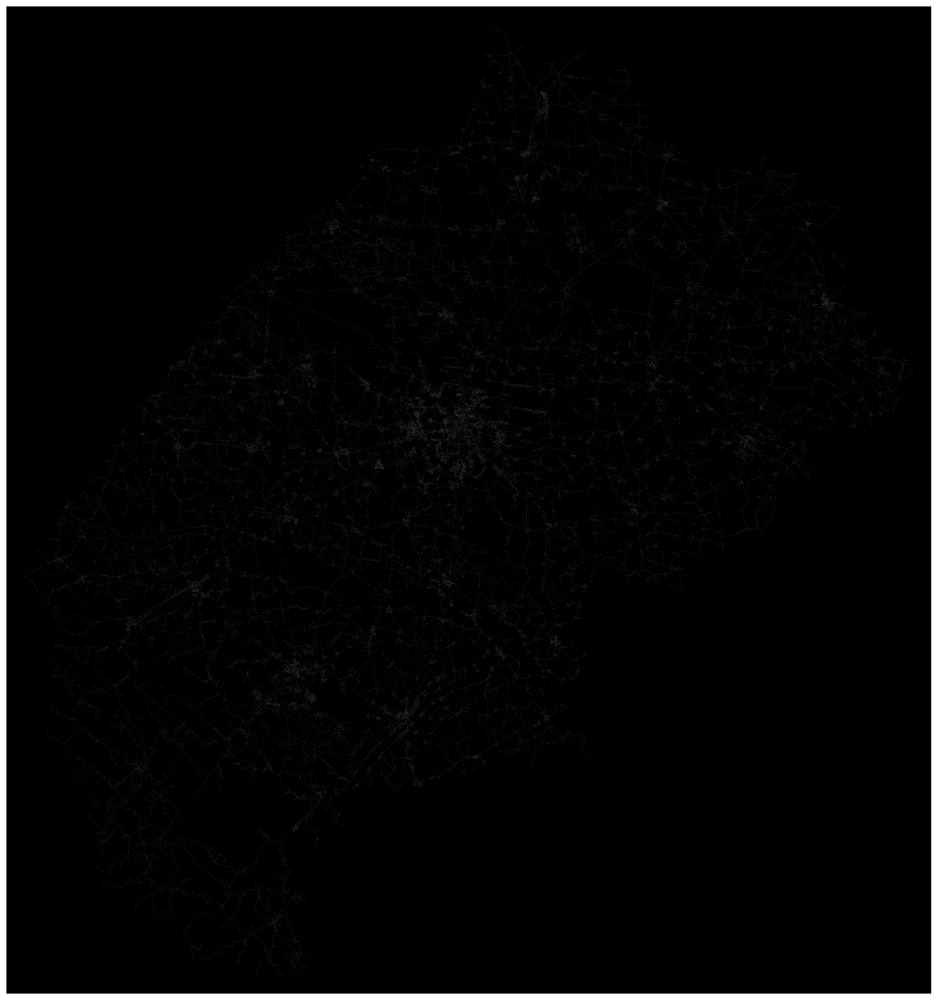

In [23]:
route_linewidths = [0.2] * len(route)

fig, ax = ox.plot_graph_route(
    G, 
    route,
    figsize=(20, 20), 
    node_size=0,
    edge_linewidth=0.02,
    bgcolor='black',
    edge_color="white",
    route_linewidth=0.02,
    route_alpha=1, 
    orig_dest_size=0.03
)

In [25]:
fig.savefig('RNNRoute.png', format='png', dpi=2000, bbox_inches='tight')

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import osmnx as ox
import networkx as nx
import random
import tqdm
import torch.nn.functional as F
import numpy as np

In [21]:
def load_map():
    return ox.graph_from_place("Lviv Oblast, Ukraine", network_type='drive')

def preprocess_graph(G):
    nodes, edges = ox.graph_to_gdfs(G)
    node_ids = list(G.nodes)
    node_map = {node_id: i for i, node_id in enumerate(node_ids)}
    return G, node_ids, node_map

def heuristic(node, end):
    if nx.has_path(G, node, end):
        return nx.shortest_path_length(G, node, end)
    return float("inf")

class RouteLSTM(nn.Module):
    def __init__(self, num_nodes, hidden_size, embedding_dim=64):
        super(RouteLSTM, self).__init__()
        self.embedding = nn.Embedding(num_nodes, embedding_dim)
        self.lstm = nn.LSTM(embedding_dim, hidden_size, batch_first=True)
        self.fc = nn.Linear(hidden_size, embedding_dim)
        self.out = nn.Linear(embedding_dim, num_nodes)

    def forward(self, x, hidden, valid_candidates):
        x = self.embedding(x)
        out, hidden = self.lstm(x, hidden)
        out = self.fc(out[:, -1, :])
        valid_embeddings = self.embedding(valid_candidates)
        similarities = torch.matmul(out, valid_embeddings.T)
        return torch.log_softmax(similarities, dim=-1), hidden

def train_model(model, G, node_ids, node_map, epochs=100):
    optimizer = optim.AdamW(model.parameters(), lr=0.0005, weight_decay=1e-4)
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.9)
    criterion = nn.CrossEntropyLoss()

    connected_nodes = max(nx.strongly_connected_components(G), key=len)  
    node_ids = list(connected_nodes)

    for epoch in tqdm.tqdm(range(epochs), desc='Training Progress'):
        total_loss = 0
        with tqdm.tqdm(range(50), desc=f'Epoch {epoch+1} Loss: 0.0000', leave=False) as pbar:
            for _ in pbar:
                start_node = random.choice(node_ids)
                neighbors = list(G.neighbors(start_node))
                if not neighbors:
                    continue
                valid_targets = [n for n in neighbors if nx.has_path(G, start_node, n)]
                if not valid_targets:
                    continue
                target_node = min(valid_targets, key=lambda n: heuristic(n, start_node))
                input_tensor = torch.tensor([node_map[start_node]], dtype=torch.long).unsqueeze(0)
                target_tensor = torch.tensor([node_map[target_node]], dtype=torch.long)
                optimizer.zero_grad()
                hidden = (torch.zeros(1, 1, 64), torch.zeros(1, 1, 64))
                valid_candidates = torch.tensor([node_map[n] for n in neighbors], dtype=torch.long)
                output, hidden = model(input_tensor, hidden, valid_candidates)
                target_idx = (valid_candidates == target_tensor.item()).nonzero(as_tuple=True)[0]
                if target_idx.numel() == 0:
                    continue
                loss = criterion(output, target_idx)
                loss.backward()
                optimizer.step()
                total_loss += loss.item()
                pbar.set_description(f'Epoch {epoch+1} Loss: {total_loss / (pbar.n+1):.4f}')
        scheduler.step()
        print(f"Epoch {epoch+1}, Total Loss: {total_loss:.4f}")
    torch.save(model.state_dict(), "route_lstm_test.pth")
    print("Model saved!")

def generate_route(model, G, start, end, node_map, node_ids, resets=0):
    model.eval()
    current_node = start
    visited = set()
    route = [current_node]
    hidden = (torch.zeros(1, 1, 64), torch.zeros(1, 1, 64))
    
    while current_node != end:
        visited.add(current_node)
        neighbors = [n for n in G.neighbors(current_node) if n not in visited]
        if not neighbors:
            if len(route) > 1:
                route.pop()
                current_node = route[-1]
                continue
            else:
                return []
        input_tensor = torch.tensor([node_map[current_node]], dtype=torch.long).unsqueeze(0)
        valid_candidates = torch.tensor([node_map[n] for n in neighbors], dtype=torch.long)
        output, hidden = model(input_tensor, hidden, valid_candidates)
        predicted_indices = torch.argsort(output, descending=True).squeeze().tolist()
        
        next_node = min(neighbors, key=lambda n: heuristic(n, end))
        
        if next_node is None:
            if len(route) > 1:
                route.pop()
                current_node = route[-1]
                continue
            else:
                return []
        
        route.append(next_node)
        current_node = next_node
        
        if len(route) > 2 * nx.shortest_path_length(G, start, end):
            resets += 1
            if resets % 100 == 0:
                print(resets)
                print("length of route:" + str(len(visited)))
            return generate_route(model, G, start, end, node_map, node_ids, resets)
    
    return route

In [3]:
G = load_map()
G, node_ids, node_map = preprocess_graph(G)

In [27]:
model = RouteLSTM(num_nodes=len(node_ids), hidden_size=64)

In [28]:
#train_model(model, G, node_ids, node_map)

In [29]:
model.load_state_dict(torch.load("route_lstm_current.pth"))
model.eval()

RouteLSTM(
  (embedding): Embedding(54436, 64)
  (lstm): LSTM(64, 64, batch_first=True)
  (fc): Linear(in_features=64, out_features=64, bias=True)
  (out): Linear(in_features=64, out_features=54436, bias=True)
)

In [30]:
start_node = ox.distance.nearest_nodes(G, 23.979556, 49.806112)
end_node = ox.distance.nearest_nodes(G, 24.032530, 49.839253)

In [31]:
resets = 0
route = generate_route(model, G, start_node, end_node, node_map, node_ids, resets)

In [32]:
print(route)

[4738389306, 1601329055, 3089011386, 3089011382, 3089011379, 6178474923, 262972935, 863256018, 1601328715, 1607982636, 803370146, 257496303, 262066923, 261711908, 261711911, 1639945845, 262065891, 4880768492, 498351947, 267159507, 1707348493, 262175945, 268679482, 2996341203, 1802186057, 1983009418, 423836103, 261713143, 341101739, 341101707, 506479547, 500020895, 268681366, 8930549581, 247249371, 247249365, 268681391, 268681610, 267112322, 1644893023, 254856966]


In [33]:
def calculate_route_length(graph, route):
    total_length = 0
    for i in range(len(route) - 1):
        node1 = route[i]
        node2 = route[i + 1]
        total_length += graph[node1][node2][0]['length']
    return total_length

In [34]:
print("Total route length:", round(calculate_route_length(G, route)/1000, 4), "km")

Total route length: 7.8053 km


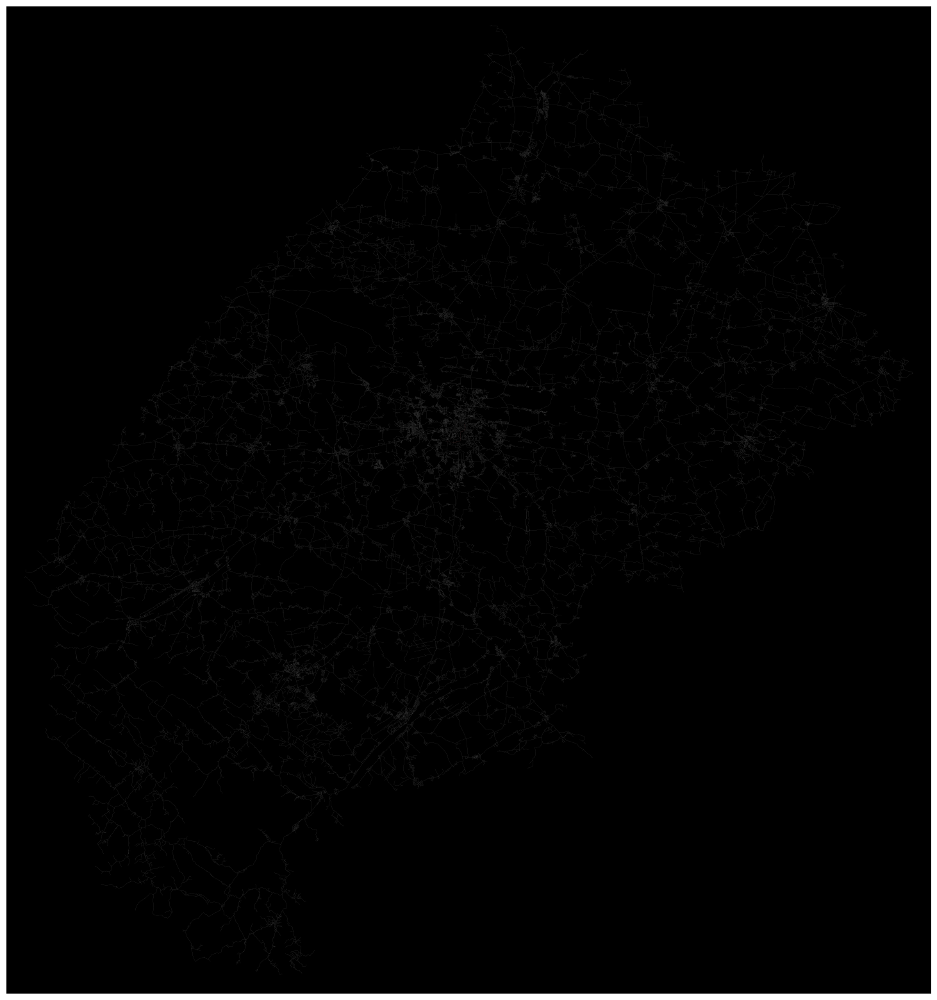

In [35]:
import matplotlib.pyplot as plt
fig, ax = ox.plot_graph_route(
    G, 
    route,
    figsize=(20, 20), 
    node_size=0,
    edge_linewidth=0.02,
    bgcolor='black',
    edge_color="white",
    route_linewidth=0.02,
    route_alpha=1, 
    orig_dest_size=0.03
)

In [18]:
#fig.savefig('TEST_LSTM.png', format='png', dpi=2000, bbox_inches='tight')